In [1]:
import os
import glob
from pathlib import Path
from typing import Dict, Tuple, List

import numpy as np
import pandas as pd
from pandas.api import types as ptypes
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, TensorDataset, random_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap.umap_ as umap
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, classification_report, roc_auc_score

import optuna

DATA_ROOT = Path("/gpfs/workdir/restrepoda")

DATASETS: Dict[str, Dict] = {
    "mBRSET": {
        "embed_dir": "Embeddings/mbrset",
        "labels_file": DATA_ROOT / "datasets/mBRSET/mbrset/labels_mbrset.csv",
        "split_file": DATA_ROOT / "datasets/mBRSET/mbrset/labels.csv",
        "embed_key": "ImageName",
        "label_key": "file",
    },
    "BRSET": {
        "embed_dir": "Embeddings/brset",
        "labels_file": DATA_ROOT / "datasets/BRSET/brset/labels_brset.csv",
        "split_file": DATA_ROOT / "datasets/BRSET/brset/labels.csv",
        "embed_key": "ImageName",   # column in embedding CSV
        "label_key": "image_id",   # column in labels file, to merge on
    },
}

VAL_SPLIT = 0.20      # % of *train* withheld for validation
BATCH_SIZE = 128
EPOCHS = 50
LEARNING_RATE = 1e-3
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

OUT_DIR = Path("embedding_reports")
OUT_DIR.mkdir(parents=True, exist_ok=True)

N_TRIALS = 30  # Optuna trials per task

#### MODEL ####

class FocalLoss(nn.Module):
    """Balanced focal loss for binary *or* multi‑class tasks."""

    def __init__(self, alpha=None, gamma: float = 2.0, reduction: str = "mean"):
        super().__init__()
        self.alpha = alpha 
        self.gamma = gamma
        self.reduction = reduction
        self.ce = nn.CrossEntropyLoss(reduction="none")

    def forward(self, logits, targets):
        # logits: [N, C], targets: [N]
        ce_loss = self.ce(logits, targets)
        pt = torch.exp(-ce_loss)
        focal = (1 - pt) ** self.gamma * ce_loss
        if self.alpha is not None:
            at = self.alpha.gather(0, targets)
            focal *= at
        return focal.mean() if self.reduction == "mean" else focal.sum()





class MLP(nn.Module):
    def __init__(
        self,
        in_dim: int,
        num_classes: int,
        hidden_sizes: Tuple[int, ...],
        dropout_rates: Tuple[float, ...],
    ):
        super().__init__()
        layers = []
        prev = in_dim
        for h, d in zip(hidden_sizes, dropout_rates):
            layers += [
                nn.Linear(prev, h),
                nn.BatchNorm1d(h),
                nn.ReLU(),
                nn.Dropout(d),
            ]
            prev = h
        layers.append(nn.Linear(prev, num_classes))
        self.net = nn.Sequential(*layers)

    def forward(self, x):
        return self.net(x)



# ------------------------- HELPERS ------------------------------------------------

def load_embeddings(fp: Path, embed_key: str) -> Tuple[pd.DataFrame, np.ndarray]:
    """Return (meta‑df, embedding‑matrix)."""
    df = pd.read_csv(fp)
    if embed_key not in df.columns:
        raise ValueError(f"Expected column '{embed_key}' in {fp.name}")
    emb = df.drop(columns=[embed_key]).values.astype(np.float32)
    return df, emb


#def merge_metadata(embed_df: pd.DataFrame, labels_df: pd.DataFrame,
#                   split_df: pd.DataFrame, embed_key: str, label_key: str) -> pd.DataFrame:

    #print(labels_df)
#    full = embed_df.merge(labels_df, left_on=embed_key, right_on=label_key, how="left")
#    full = full.merge(split_df, on=label_key, how="left")#

#    full = full[full['split'].notna()]

#    if 'age' in full.columns:
#        full.age = full.age.apply(lambda x: 90 if x == '>= 90' else x)
    
#    if full["split"].isnull().any():
        
#        raise RuntimeError("Some images missing split information after merge!")
    
#    return full


def merge_metadata(
    embed_df: pd.DataFrame,
    embeddings: np.ndarray,
    labels_df: pd.DataFrame,
    split_df: pd.DataFrame,
    embed_key: str,
    label_key: str
) -> Tuple[pd.DataFrame, np.ndarray]:
    
    # keep track of which row in emb matches which row in embed_df
    embed_df = embed_df.copy()
    embed_df["_orig_idx"] = np.arange(len(embed_df))

    # merge in labels and split info
    full = (
        embed_df
        .merge(labels_df, left_on=embed_key, right_on=label_key, how="left")
        .merge(split_df,   on=label_key,                how="left")
    )

    # drop rows with no split
    full = full[full["split"].notna()].reset_index(drop=True)

    # convert ages if needed
    if "age" in full.columns:
        full["age"] = full["age"].map(lambda x: 90 if x == ">= 90" else x)

    # sanity check
    if full["split"].isnull().any():
        raise RuntimeError("Some images missing split information after merge!")

    # pull out the rows of emb we kept
    keep_idx = full["_orig_idx"].astype(int).values
    emb_filtered = embeddings[keep_idx]

    # drop our helper column and return
    full = full.drop(columns=["_orig_idx"])
    return full, emb_filtered


def make_age_group(series: pd.Series, bins: List[int] = None) -> pd.Series:
    if bins is None:
        bins = list(range(0, 100, 10)) + [150]
    labels = [f"{b}‑{b + 9}" for b in bins[:-2]] + [f"{bins[-2]}+"]
    return pd.cut(series.astype(float), bins=bins, labels=labels, right=False)



def visualise(
    X: np.ndarray,
    df: pd.DataFrame,
    title: str,
    colour_col: str,
    figsize: Tuple[int,int] = (12, 5)
):
    # Standardise
    X_std = StandardScaler().fit_transform(X)

    # Compute 2D embeddings
    pca_2d  = PCA(n_components=2).fit_transform(X_std)
    umap_2d = umap.UMAP(n_components=2, random_state=42).fit_transform(X_std)

    # Prepare colour values & bar settings
    vals = df[colour_col]
    if ptypes.is_numeric_dtype(vals):
        c_vals    = vals.astype(float).values
        cmap      = "viridis"
        bar_label = colour_col
        bar_ticks = bar_ticklabels = None

    elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:
        c_vals    = vals.cat.codes.astype(float)
        cmap      = "viridis"
        bar_label = None
        bar_ticks = np.arange(len(vals.cat.categories))
        bar_ticklabels = vals.cat.categories.tolist()

    else:
        if ptypes.is_categorical_dtype(vals):
            categories = list(vals.cat.categories)
            codes      = vals.cat.codes.values
        else:
            categories = sorted(vals.unique().tolist())
            codes      = pd.Categorical(vals, categories=categories).codes
        c_vals    = codes
        cmap      = plt.get_cmap("tab10", len(categories))
        bar_label = None
        bar_ticks = list(range(len(categories)))
        bar_ticklabels = categories

    # Plot side-by-side with constrained layout
    fig, axes = plt.subplots(
        1, 2,
        figsize=figsize,
        constrained_layout=True
    )

    fig.suptitle(f"{title} coloured by {colour_col}")

    for ax, emb2d, method in zip(
        axes, (pca_2d, umap_2d), ("PCA", "UMAP")
    ):
        sc = ax.scatter(
            emb2d[:, 0], emb2d[:, 1],
            c=c_vals, s=5, alpha=0.7,
            cmap=cmap
        )
        ax.set_title(f"Reduction: {method}")
        ax.axis("off")

    # Shared colourbar
    cbar = fig.colorbar(
        sc,
        ax=axes,
        orientation="vertical",
        fraction=0.03,
        pad=0.04,
        label=bar_label  # only label here
    )

    # If categorical, set ticks & ticklabels after creation
    if bar_ticks is not None:
        cbar.set_ticks(bar_ticks)
        cbar.set_ticklabels(bar_ticklabels)

    plt.show()



"""
def visualise(X: np.ndarray, df: pd.DataFrame, title: str, colour_col: str, method: str = "umap"):
    # Standardise
    X_std = StandardScaler().fit_transform(X)

    # Reduce dimensionality 
    if method == "pca":
        reducer = PCA(n_components=2) 
    else:
        reducer = umap.UMAP(n_components=2, random_state=42)
        
    X_2d = reducer.fit_transform(X_std)

    # Select the colors
    vals = df[colour_col]

    if ptypes.is_numeric_dtype(vals):
        # true numeric → gradient
        c = vals.astype(float).values
        cmap = "viridis"
        bar_kwargs = {"label": colour_col}

    elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:
        # ordered categories → treat codes as “pseudo-numeric”
        codes = vals.cat.codes.astype(float)
        c = codes
        cmap = "viridis"
        # we'll label ticks at integer code positions
        ticks = np.arange(len(vals.cat.categories))
        ticklabels = vals.cat.categories.tolist()
        bar_kwargs = {"ticks": ticks, "ticklabels": ticklabels}

    else:
        # unordered categories → qualitative palette
        if ptypes.is_categorical_dtype(vals):
            cats = list(vals.cat.categories)
            codes = vals.cat.codes.values
        else:
            cats = sorted(vals.unique().tolist())
            codes = pd.Categorical(vals, categories=cats).codes
        c = codes
        cmap = plt.get_cmap("tab10", len(cats))
        bar_kwargs = {"ticks": range(len(cats)), "ticklabels": cats}


    # plot
    plt.figure(figsize=(6, 5))
    sc = plt.scatter(
        X_2d[:, 0],
        X_2d[:, 1],
        c=c,
        s=5,
        alpha=0.7,
        cmap=cmap
    )
    plt.title(f"{title} – {method.upper()} coloured by {colour_col}")
    plt.axis("off")

    # Adjust colourbar
    cb = plt.colorbar(sc)
    if "label" in bar_kwargs:
        cb.set_label(bar_kwargs["label"])
    else:
        cb.set_ticks(bar_kwargs["ticks"])
        cb.set_ticklabels(bar_kwargs["ticklabels"])

    plt.tight_layout()
    plt.show()

"""

def make_dataloaders(X: np.ndarray, y: np.ndarray, batch: int, val_split: float):
    tensor_x = torch.tensor(X)
    tensor_y = torch.tensor(y)
    dataset = TensorDataset(tensor_x, tensor_y)
    val_len = int(len(dataset) * val_split)
    train_len = len(dataset) - val_len
    train_set, val_set = random_split(dataset, [train_len, val_len], generator=torch.Generator().manual_seed(42))
    train_loader = DataLoader(train_set, batch_size=batch, shuffle=True)
    val_loader = DataLoader(val_set, batch_size=batch, shuffle=False)
    return train_loader, val_loader


def train_one(model, loaders, criterion, optimizer, epochs=EPOCHS):
    train_loader, val_loader = loaders
    best_val_acc = 0.0
    for ep in range(1, epochs + 1):
        model.train()
        for xb, yb in train_loader:
            xb, yb = xb.to(DEVICE), yb.to(DEVICE)
            optimizer.zero_grad()
            logits = model(xb)
            loss = criterion(logits, yb)
            loss.backward()
            optimizer.step()
        if ep % 5 == 0 or ep == epochs:
            val_acc = evaluate(model, val_loader)["acc"]
            best_val_acc = max(best_val_acc, val_acc)
    return best_val_acc


def evaluate(model, loader):
    model.eval()
    all_logits, all_y = [], []
    with torch.no_grad():
        for xb, yb in loader:
            logits = model(xb.to(DEVICE))
            all_logits.append(logits.cpu())
            all_y.append(yb)
    logits = torch.cat(all_logits)
    y_true = torch.cat(all_y)
    y_pred = logits.argmax(1)
    acc = accuracy_score(y_true, y_pred)

    probs = torch.softmax(logits, 1).numpy()
    if probs.shape[1] == 2:
        # binary: use the positive‐class probability only
        auroc = roc_auc_score(y_true, probs[:, 1])
    else:
        # multiclass
        auroc = roc_auc_score(y_true, probs, multi_class="ovr")

    
    #try:
    #    auroc = roc_auc_score(y_true, torch.softmax(logits, 1).numpy(), multi_class="ovr")
    #except ValueError:
    #    auroc = np.nan
    return {"acc": acc, "auroc": auroc, "y_true": y_true.numpy(), "y_pred": y_pred.numpy()}


def objective(trial, X_train, y_train, in_dim, num_classes):
    # Hyperparams
    hidden1 = trial.suggest_int("hidden1", 128, 512, step=128)
    hidden2 = trial.suggest_int("hidden2", 64, 256, step=64)
    drop1  = trial.suggest_float("drop1", 0.1, 0.5, step=0.1)
    drop2  = trial.suggest_float("drop2", 0.1, 0.5, step=0.1)
    lr     = trial.suggest_float("lr", 1e-5, 1e-2, log=True)
    gamma  = trial.suggest_float("gamma", 1.0, 3.0, step=0.5)
    bs     = trial.suggest_categorical("batch_size", [64, 128])

    # Prepare
    tr_loader, vl_loader = make_dataloaders(X_train, y_train, bs, VAL_SPLIT)
    model = MLP(in_dim, num_classes, (hidden1,hidden2), (drop1,drop2)).to(DEVICE)
    counts = np.bincount(y_train, minlength=num_classes)
    alpha = torch.tensor(1.0 - counts/counts.sum(), device=DEVICE)
    criterion = FocalLoss(alpha=alpha, gamma=gamma)
    optimizer = torch.optim.AdamW(model.parameters(), lr=lr)

    # 3) train & return best val acc
    return train_one(model, (tr_loader, vl_loader), criterion, optimizer, EPOCHS)



#### MAIN ####

def run_pipeline(cfg: Dict):
    embed_dir = Path(cfg["embed_dir"])
    #embed_dir = cfg["embed_dir"]
    label_df = pd.read_csv(cfg["labels_file"])
    split_df = pd.read_csv(cfg["split_file"])

    if '/BRSET/' in str(cfg["labels_file"]) and '/BRSET/' in str(cfg["split_file"]):
        label_df[cfg["label_key"]] = label_df[cfg["label_key"]] + '.jpg'
        split_df[cfg["label_key"]] = split_df[cfg["label_key"]] + '.jpg'

    results = []

    for fp in sorted(embed_dir.glob("*.csv")):
        print(f"\n=== Processing {fp.name} ===")
        embed_df, emb = load_embeddings(fp, cfg["embed_key"])
        #full = merge_metadata(embed_df, label_df, split_df, cfg["embed_key"], cfg["label_key"])
        full, emb = merge_metadata(
            embed_df, emb,
            label_df, split_df,
            cfg["embed_key"], cfg["label_key"]
        )
        
        # Create visual summaries
        full["age_group"] = make_age_group(full["patient_age"] if "patient_age" in full
                                            else full["age"])
        
        #visualise(emb, full, fp.stem, "patient_sex" if "patient_sex" in full else "sex", method=method)
        #visualise(emb, full, fp.stem, "age_group", method=method)

        for col in ("patient_sex" if "patient_sex" in full else "sex", "age_group"):
            visualise(emb, full, fp.stem, col)

        # Train & Evaluate MLP (Binary + 3‑class)
        for task, label_col, n_class in [
            ("binary", "DR_2", 2),
            ("3class", "DR_3", 3),
        ]:
            if label_col not in full.columns:
                print(f"Skipping {task}: '{label_col}' not in metadata")
                continue
            task_df = full.dropna(subset=[label_col])
            if task_df[label_col].nunique() < n_class:
                print(f"Skipping {task}: only {task_df[label_col].unique()} classes present")
                continue

            # Split sets using the official split
            X_train = emb[task_df["split"] == "train"]
            y_train = task_df.loc[task_df["split"] == "train", label_col].astype(int).values
            X_test = emb[task_df["split"] == "test"]
            y_test = task_df.loc[task_df["split"] == "test", label_col].astype(int).values

            # Scale
            scaler = StandardScaler().fit(X_train)
            X_train = scaler.transform(X_train)
            X_test = scaler.transform(X_test)

            in_dim, num_classes = X_train.shape[1], n_class

            # Hyperparameters
            study = optuna.create_study(direction="maximize")
            study.optimize(lambda t: objective(t, X_train, y_train, in_dim, num_classes),
                           n_trials=N_TRIALS, show_progress_bar=False)
            best = study.best_params
            print(f"→ Best params for {task}:", best)


            # Train & eval with best params
            tr_loader, val_loader = make_dataloaders(X_train, y_train, best["batch_size"], VAL_SPLIT)
            test_loader = DataLoader(TensorDataset(torch.tensor(X_test), torch.tensor(y_test)),
                                     batch_size=best["batch_size"], shuffle=False)

            #train_loader, val_loader = make_dataloaders(X_train, y_train, BATCH_SIZE, VAL_SPLIT)
            #test_loader = DataLoader(TensorDataset(torch.tensor(X_test), torch.tensor(y_test)),
            #                          batch_size=BATCH_SIZE, shuffle=False)
            #model = MLP(in_dim=X_train.shape[1], num_classes=n_class).to(DEVICE)
            
            model = MLP(in_dim, num_classes,
                        (best["hidden1"],best["hidden2"]),
                        (best["drop1"],best["drop2"])
                       ).to(DEVICE)

            # Balanced focal loss alpha
            class_counts = np.bincount(y_train, minlength=n_class)
            alpha = torch.tensor(1.0 - class_counts / class_counts.sum(), dtype=torch.float32, device=DEVICE)
            criterion = FocalLoss(alpha=alpha, gamma=best["gamma"])
            optim = torch.optim.AdamW(model.parameters(), lr=best["lr"])

            best_val = train_one(model, (tr_loader, val_loader), criterion, optim)
            perf = evaluate(model, test_loader)
            print(f"{task.upper()} – Test acc={perf['acc']:.3f}, AUROC={perf['auroc']:.3f}")
            print(classification_report(perf["y_true"], perf["y_pred"], digits=3))

            results.append({
                "dataset": embed_dir.name,
                "file": fp.name,
                "task": task,
                "val_acc": study.best_value,
                "test_acc": perf["acc"],
                "test_auroc": perf["auroc"],
            })
    
    # Save CSV summary for the dataset
    pd.DataFrame(results).to_csv(OUT_DIR / f"summary_{embed_dir.name}.csv", index=False)


=== Processing Embeddings_convnextv2_base-mBRSET-byol.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


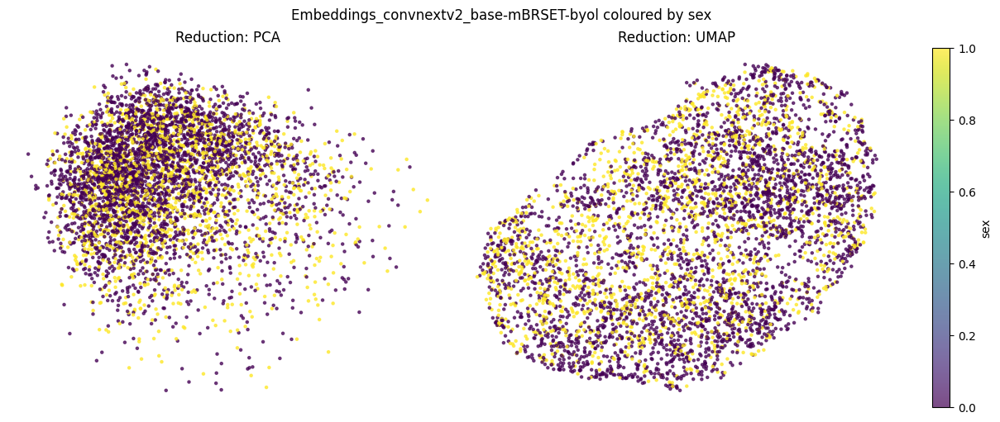

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


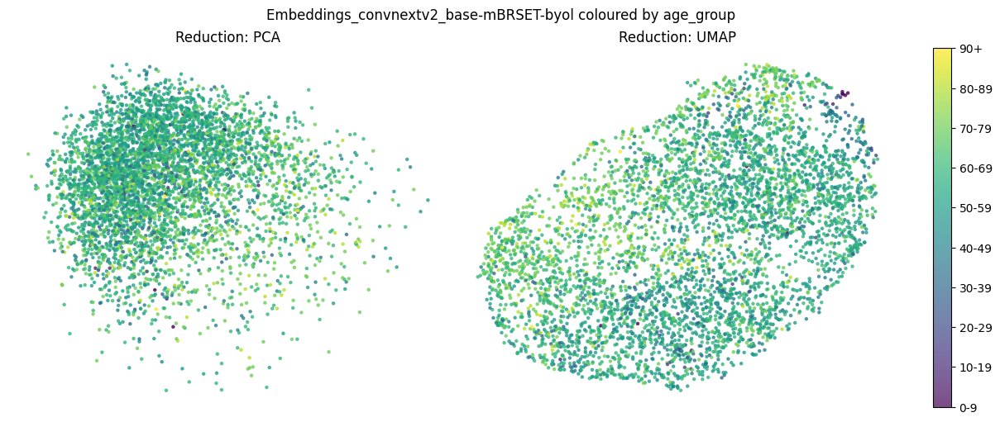

[I 2025-05-07 20:54:42,770] A new study created in memory with name: no-name-a5f1cd34-d17b-4fa6-a41f-93c117f1e4c5
[I 2025-05-07 20:56:13,058] Trial 0 finished with value: 0.8437900128040973 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.1, 'lr': 7.915215210819808e-05, 'gamma': 1.5, 'batch_size': 64}. Best is trial 0 with value: 0.8437900128040973.
[I 2025-05-07 20:56:17,872] Trial 1 finished with value: 0.8309859154929577 and parameters: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 0.00033696002118063, 'gamma': 1.5, 'batch_size': 128}. Best is trial 0 with value: 0.8437900128040973.
[I 2025-05-07 20:56:21,958] Trial 2 finished with value: 0.8258642765685019 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.4, 'lr': 0.004143103775740079, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.8437900128040973.
[I 2025-05-07 20:56:26,001] Trial 3 finished with value: 0.8565941101152369 and par

→ Best params for binary: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.2, 'drop2': 0.2, 'lr': 0.00011480742916035161, 'gamma': 1.0, 'batch_size': 128}


[I 2025-05-07 20:58:31,948] A new study created in memory with name: no-name-df1afb9e-b48a-4def-8285-8eb648e77879


BINARY – Test acc=0.835, AUROC=0.844
              precision    recall  f1-score   support

           0      0.896     0.888     0.892       750
           1      0.641     0.661     0.651       227

    accuracy                          0.835       977
   macro avg      0.769     0.774     0.771       977
weighted avg      0.837     0.835     0.836       977



[I 2025-05-07 20:58:39,486] Trial 0 finished with value: 0.8322663252240717 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.4, 'drop2': 0.1, 'lr': 0.0008161857949562762, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.8322663252240717.
[I 2025-05-07 20:58:43,536] Trial 1 finished with value: 0.7746478873239436 and parameters: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.30000000000000004, 'lr': 1.4289893900766848e-05, 'gamma': 2.5, 'batch_size': 128}. Best is trial 0 with value: 0.8322663252240717.
[I 2025-05-07 20:58:47,674] Trial 2 finished with value: 0.8169014084507042 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.1, 'drop2': 0.1, 'lr': 1.7183558996158916e-05, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.8322663252240717.
[I 2025-05-07 20:58:54,430] Trial 3 finished with value: 0.8130601792573624 and parameters: {'hidden1': 128, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 

→ Best params for 3class: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.4, 'lr': 8.332115126793162e-05, 'gamma': 1.0, 'batch_size': 64}
3CLASS – Test acc=0.820, AUROC=0.874
              precision    recall  f1-score   support

           0      0.895     0.883     0.889       750
           1      0.544     0.573     0.558       185
           2      0.786     0.786     0.786        42

    accuracy                          0.820       977
   macro avg      0.741     0.747     0.744       977
weighted avg      0.823     0.820     0.822       977


=== Processing Embeddings_convnextv2_base-mBRSET-contrastive.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


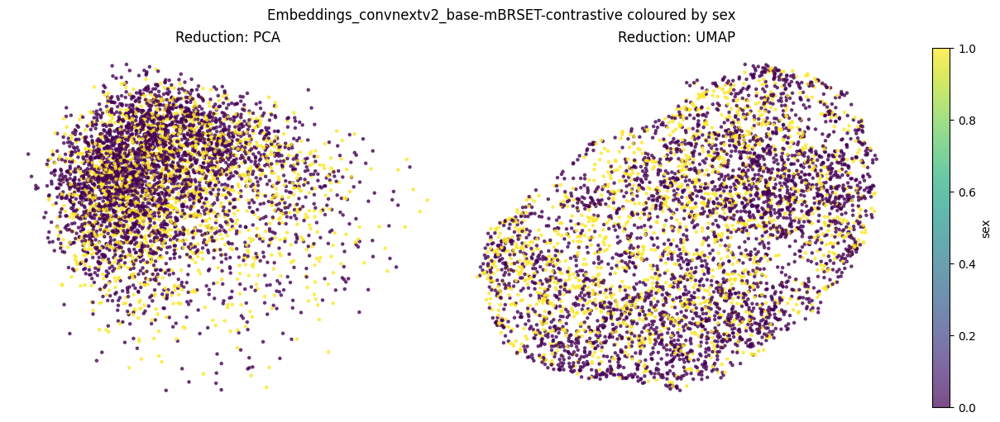

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


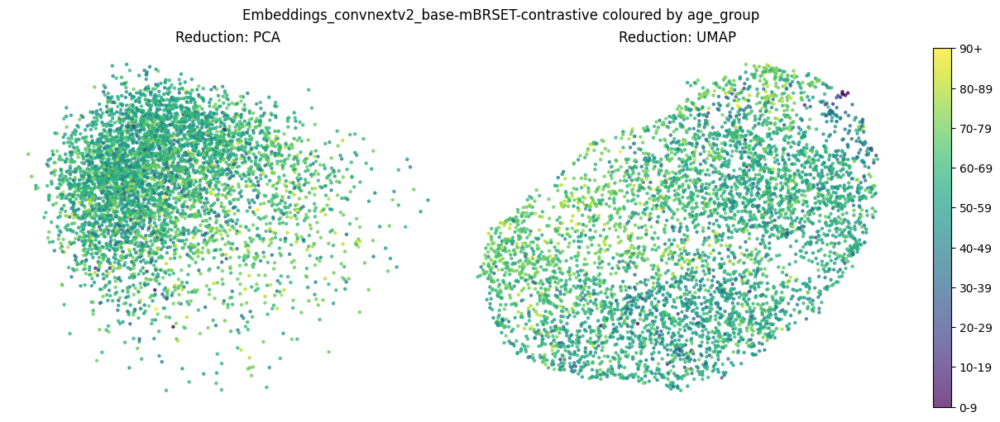

[I 2025-05-07 21:02:11,140] A new study created in memory with name: no-name-c2e3bcc5-a8ea-47eb-a019-fa0776bcb281
[I 2025-05-07 21:02:15,210] Trial 0 finished with value: 0.8322663252240717 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.4, 'lr': 0.0017224101798628457, 'gamma': 1.0, 'batch_size': 128}. Best is trial 0 with value: 0.8322663252240717.
[I 2025-05-07 21:02:19,297] Trial 1 finished with value: 0.8386683738796414 and parameters: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.2, 'lr': 0.0002698725957615693, 'gamma': 1.0, 'batch_size': 128}. Best is trial 1 with value: 0.8386683738796414.
[I 2025-05-07 21:02:25,221] Trial 2 finished with value: 0.8258642765685019 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.2, 'drop2': 0.4, 'lr': 0.006872709899717833, 'gamma': 3.0, 'batch_size': 128}. Best is trial 1 with value: 0.8386683738796414.
[I 2025-05-07 21:02:31,903] Trial 3 finished with value: 0.8412291933418694 and parameters: {'hid

→ Best params for binary: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 9.342181934017136e-05, 'gamma': 1.5, 'batch_size': 64}


[I 2025-05-07 21:05:21,182] A new study created in memory with name: no-name-d3dfc1b7-8bbf-4910-96b0-44bce19dd630


BINARY – Test acc=0.864, AUROC=0.845
              precision    recall  f1-score   support

           0      0.899     0.927     0.913       750
           1      0.730     0.656     0.691       227

    accuracy                          0.864       977
   macro avg      0.815     0.792     0.802       977
weighted avg      0.860     0.864     0.861       977



[I 2025-05-07 21:05:25,301] Trial 0 finished with value: 0.8092189500640204 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.2, 'lr': 0.0007169011712269588, 'gamma': 1.0, 'batch_size': 128}. Best is trial 0 with value: 0.8092189500640204.
[I 2025-05-07 21:05:29,368] Trial 1 finished with value: 0.8015364916773368 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.2, 'lr': 3.146290018045306e-05, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.8092189500640204.
[I 2025-05-07 21:05:36,135] Trial 2 finished with value: 0.8156209987195903 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 0.009811463322437082, 'gamma': 1.0, 'batch_size': 64}. Best is trial 2 with value: 0.8156209987195903.
[I 2025-05-07 21:05:40,220] Trial 3 finished with value: 0.7708066581306018 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.2, 'lr': 3.152978939963313e-05

→ Best params for 3class: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.1, 'drop2': 0.4, 'lr': 0.00013538578033063067, 'gamma': 1.0, 'batch_size': 128}
3CLASS – Test acc=0.823, AUROC=0.875
              precision    recall  f1-score   support

           0      0.893     0.895     0.894       750
           1      0.562     0.562     0.562       185
           2      0.707     0.690     0.699        42

    accuracy                          0.823       977
   macro avg      0.721     0.716     0.718       977
weighted avg      0.823     0.823     0.823       977


=== Processing Embeddings_convnextv2_base-mBRSET-dino.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


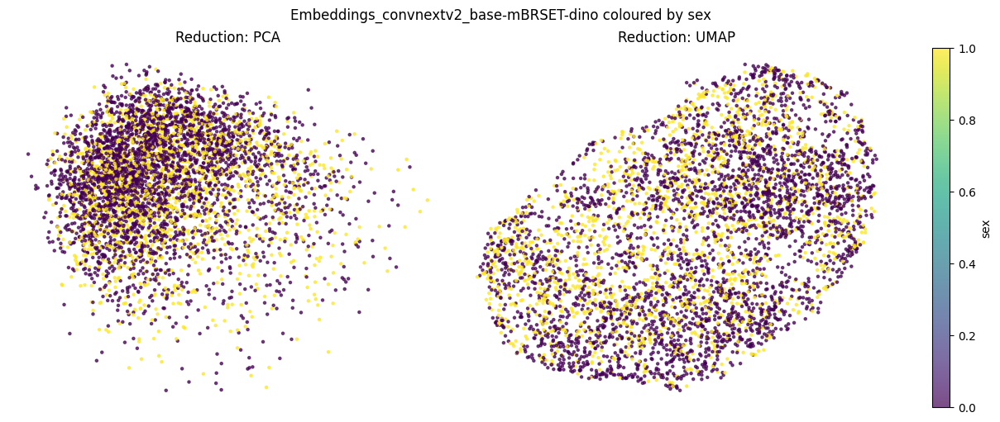

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


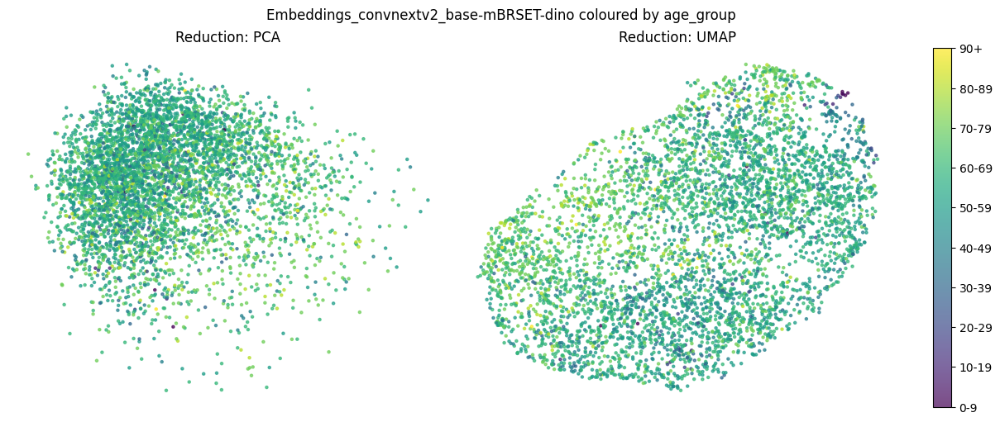

[I 2025-05-07 21:08:12,944] A new study created in memory with name: no-name-40dfc4a4-871a-4f2c-b460-5a417399d223
[I 2025-05-07 21:08:17,003] Trial 0 finished with value: 0.8322663252240717 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.5, 'lr': 0.006049072101816791, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.8322663252240717.
[I 2025-05-07 21:08:23,688] Trial 1 finished with value: 0.8322663252240717 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.002804016844620986, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.8322663252240717.
[I 2025-05-07 21:08:30,406] Trial 2 finished with value: 0.8463508322663252 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.2, 'drop2': 0.1, 'lr': 0.0002630861116930354, 'gamma': 2.5, 'batch_size': 64}. Best is trial 2 with value: 0.8463508322663252.
[I 2025-05-07 21:08:37,056] Trial 3 finished with value: 0.8361075544174136 and parameters: {'hidde

→ Best params for binary: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.2, 'drop2': 0.2, 'lr': 0.00010670942005090668, 'gamma': 2.0, 'batch_size': 128}


[I 2025-05-07 21:11:15,259] A new study created in memory with name: no-name-c9a6b9bc-1a03-4ffe-bf70-71555921dffe


BINARY – Test acc=0.849, AUROC=0.838
              precision    recall  f1-score   support

           0      0.900     0.903     0.901       750
           1      0.676     0.670     0.673       227

    accuracy                          0.849       977
   macro avg      0.788     0.786     0.787       977
weighted avg      0.848     0.849     0.848       977



[I 2025-05-07 21:11:19,298] Trial 0 finished with value: 0.7976952624839949 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.2, 'lr': 3.757448782395102e-05, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.7976952624839949.
[I 2025-05-07 21:11:23,335] Trial 1 finished with value: 0.8399487836107554 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.4, 'lr': 0.0022634686159858962, 'gamma': 3.0, 'batch_size': 128}. Best is trial 1 with value: 0.8399487836107554.
[I 2025-05-07 21:11:30,009] Trial 2 finished with value: 0.8015364916773368 and parameters: {'hidden1': 128, 'hidden2': 128, 'drop1': 0.4, 'drop2': 0.1, 'lr': 6.869987917994849e-05, 'gamma': 1.5, 'batch_size': 64}. Best is trial 1 with value: 0.8399487836107554.
[I 2025-05-07 21:11:34,063] Trial 3 finished with value: 0.765685019206146 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.5, 'drop2': 0.4, 'lr': 1.0199388268654127e-05, 'gamma': 3.0, 'batch_size': 1

→ Best params for 3class: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.4, 'lr': 0.0022634686159858962, 'gamma': 3.0, 'batch_size': 128}
3CLASS – Test acc=0.814, AUROC=0.865
              precision    recall  f1-score   support

           0      0.891     0.889     0.890       750
           1      0.533     0.524     0.529       185
           2      0.674     0.738     0.705        42

    accuracy                          0.814       977
   macro avg      0.699     0.717     0.708       977
weighted avg      0.814     0.814     0.814       977


=== Processing Embeddings_convnextv2_base.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


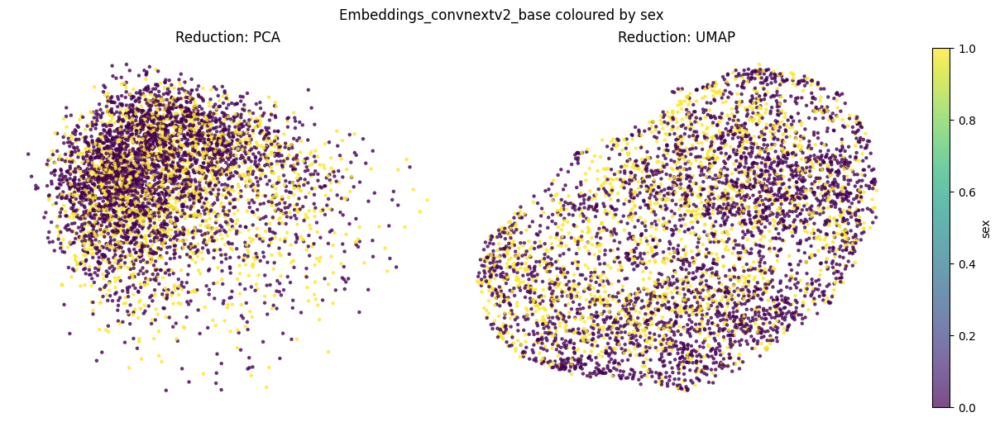

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


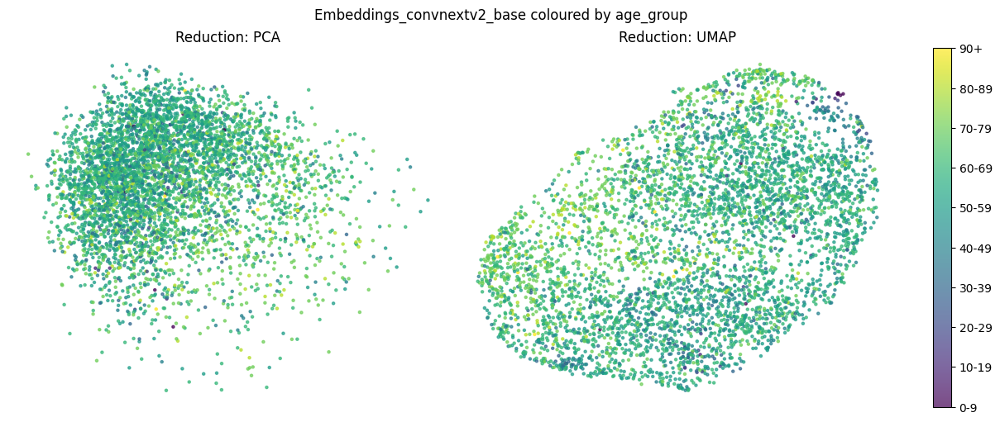

[I 2025-05-07 21:14:32,221] A new study created in memory with name: no-name-1314c206-969e-471a-b66b-77afde538711
[I 2025-05-07 21:14:38,962] Trial 0 finished with value: 0.8399487836107554 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 0.00014681861932245522, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.8399487836107554.
[I 2025-05-07 21:14:43,029] Trial 1 finished with value: 0.8284250960307298 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.5, 'drop2': 0.1, 'lr': 0.0002492024808277272, 'gamma': 2.5, 'batch_size': 128}. Best is trial 0 with value: 0.8399487836107554.
[I 2025-05-07 21:14:49,799] Trial 2 finished with value: 0.8220230473751601 and parameters: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.5, 'drop2': 0.1, 'lr': 0.006067199924752965, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.8399487836107554.
[I 2025-05-07 21:14:56,538] Trial 3 finished with value: 0.8220230473751601 and 

→ Best params for binary: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 0.0004532032890969093, 'gamma': 2.5, 'batch_size': 128}


[I 2025-05-07 21:17:07,956] A new study created in memory with name: no-name-0e363a9f-35e5-4e2e-90ec-9e3f37671a0f


BINARY – Test acc=0.845, AUROC=0.847
              precision    recall  f1-score   support

           0      0.900     0.899     0.899       750
           1      0.667     0.670     0.668       227

    accuracy                          0.845       977
   macro avg      0.783     0.784     0.784       977
weighted avg      0.846     0.845     0.846       977



[I 2025-05-07 21:17:14,650] Trial 0 finished with value: 0.8169014084507042 and parameters: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.5, 'lr': 0.0017927925501534951, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.8169014084507042.
[I 2025-05-07 21:17:21,346] Trial 1 finished with value: 0.8028169014084507 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.4, 'lr': 7.125569799052918e-05, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.8169014084507042.
[I 2025-05-07 21:17:25,387] Trial 2 finished with value: 0.8040973111395646 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 4.128024821785914e-05, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.8169014084507042.
[I 2025-05-07 21:17:32,115] Trial 3 finished with value: 0.8104993597951344 and parameters: {'hidden1': 128, 'hidden2': 128, 'drop1': 0.4, 'drop2': 0.5, 'lr': 0.00012697845192640624, 'gamma': 1.0,

→ Best params for 3class: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.4, 'drop2': 0.2, 'lr': 0.0006623589488986963, 'gamma': 1.5, 'batch_size': 64}
3CLASS – Test acc=0.811, AUROC=0.861
              precision    recall  f1-score   support

           0      0.886     0.883     0.884       750
           1      0.526     0.546     0.536       185
           2      0.763     0.690     0.725        42

    accuracy                          0.811       977
   macro avg      0.725     0.706     0.715       977
weighted avg      0.813     0.811     0.812       977


=== Processing Embeddings_dinov2_base-mBRSET-byol.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


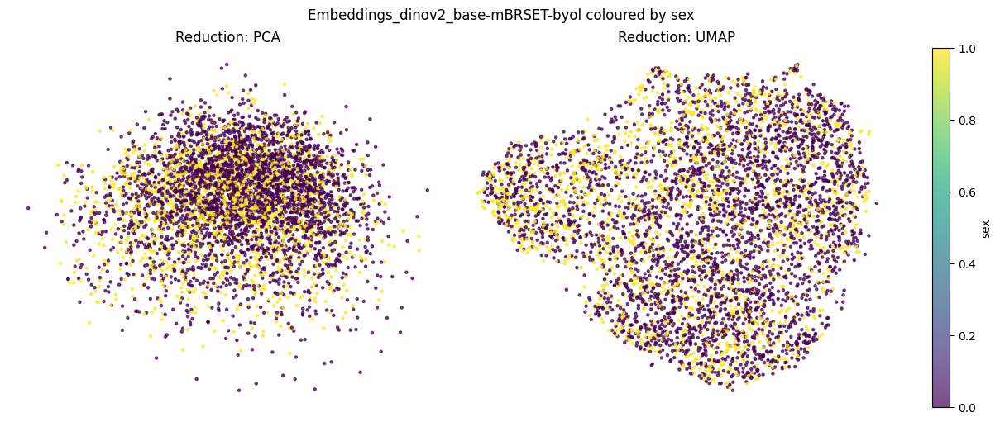

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


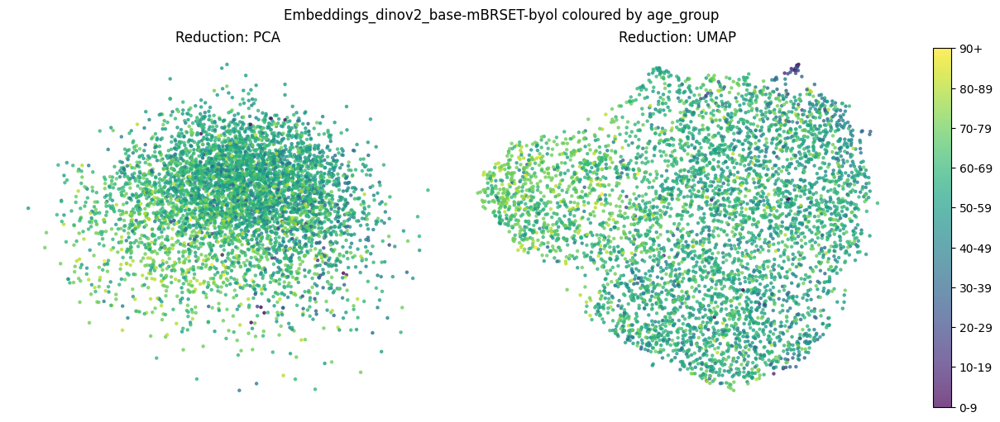

[I 2025-05-07 21:20:45,988] A new study created in memory with name: no-name-e22dd5e2-9737-4594-9cb7-2cafa5e20c2a
[I 2025-05-07 21:20:49,962] Trial 0 finished with value: 0.8642765685019206 and parameters: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.1, 'lr': 0.008801668613288906, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.8642765685019206.
[I 2025-05-07 21:20:56,614] Trial 1 finished with value: 0.8565941101152369 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 0.0009615364436049595, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.8642765685019206.
[I 2025-05-07 21:21:03,328] Trial 2 finished with value: 0.8591549295774648 and parameters: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.1, 'lr': 0.0006336733461705798, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.8642765685019206.
[I 2025-05-07 21:21:07,325] Trial 3 finished with value: 0.8629961587708067 and p

→ Best params for binary: {'hidden1': 384, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.00012776191151802024, 'gamma': 1.0, 'batch_size': 128}


[I 2025-05-07 21:23:09,470] A new study created in memory with name: no-name-d35ff5d3-cb3a-4567-b465-12f9baa65bd7


BINARY – Test acc=0.854, AUROC=0.874
              precision    recall  f1-score   support

           0      0.897     0.915     0.906       750
           1      0.698     0.652     0.674       227

    accuracy                          0.854       977
   macro avg      0.797     0.783     0.790       977
weighted avg      0.851     0.854     0.852       977



[I 2025-05-07 21:23:16,132] Trial 0 finished with value: 0.8412291933418694 and parameters: {'hidden1': 128, 'hidden2': 256, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 0.0030753102300871446, 'gamma': 3.0, 'batch_size': 64}. Best is trial 0 with value: 0.8412291933418694.
[I 2025-05-07 21:23:22,871] Trial 1 finished with value: 0.8629961587708067 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 0.00010632446255142068, 'gamma': 1.0, 'batch_size': 64}. Best is trial 1 with value: 0.8629961587708067.
[I 2025-05-07 21:23:27,013] Trial 2 finished with value: 0.8450704225352113 and parameters: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.4, 'drop2': 0.5, 'lr': 0.00794443728846567, 'gamma': 2.0, 'batch_size': 128}. Best is trial 1 with value: 0.8629961587708067.
[I 2025-05-07 21:23:31,070] Trial 3 finished with value: 0.7618437900128041 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 3.55

→ Best params for 3class: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 0.00010632446255142068, 'gamma': 1.0, 'batch_size': 64}
3CLASS – Test acc=0.833, AUROC=0.875
              precision    recall  f1-score   support

           0      0.887     0.915     0.901       750
           1      0.577     0.508     0.540       185
           2      0.829     0.810     0.819        42

    accuracy                          0.833       977
   macro avg      0.764     0.744     0.753       977
weighted avg      0.826     0.833     0.829       977


=== Processing Embeddings_dinov2_base-mBRSET-contrastive.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


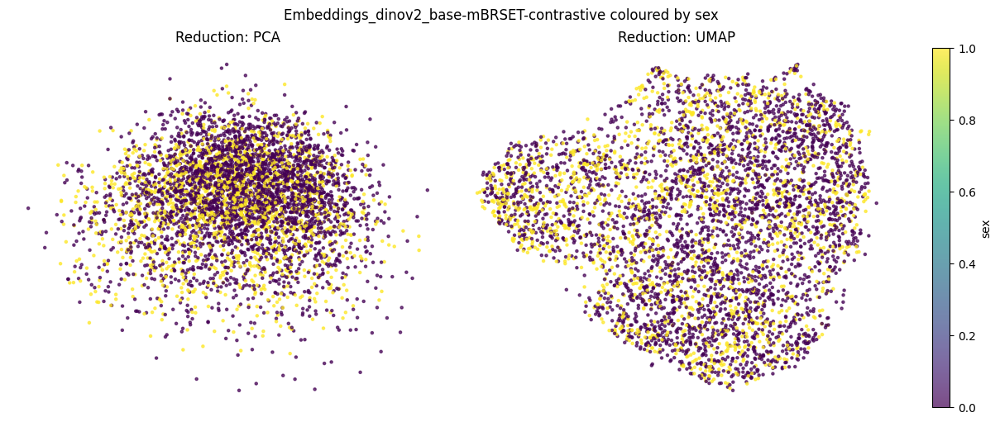

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


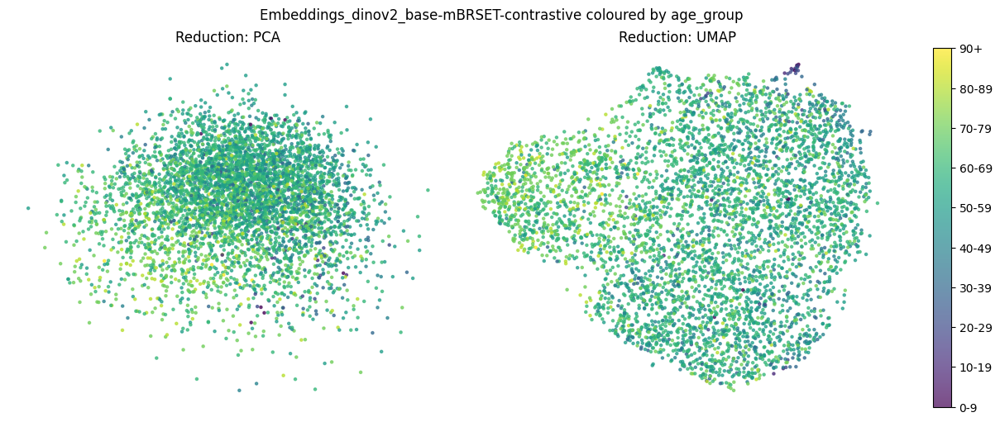

[I 2025-05-07 21:26:31,937] A new study created in memory with name: no-name-4142f726-6537-4ca2-8d56-bcd8672702dd
[I 2025-05-07 21:26:38,638] Trial 0 finished with value: 0.8591549295774648 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 6.354720622268016e-05, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.8591549295774648.
[I 2025-05-07 21:26:42,734] Trial 1 finished with value: 0.8642765685019206 and parameters: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.5, 'drop2': 0.1, 'lr': 0.0004302673732346082, 'gamma': 1.0, 'batch_size': 128}. Best is trial 1 with value: 0.8642765685019206.
[I 2025-05-07 21:26:49,432] Trial 2 finished with value: 0.8322663252240717 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.5, 'lr': 5.4948079612085224e-05, 'gamma': 1.5, 'batch_size': 64}. Best is trial 1 with value: 0.8642765685019206.
[I 2025-05-07 21:26:53,466] Trial 3 finished with value: 0.88092

→ Best params for binary: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.0002169298024096293, 'gamma': 1.5, 'batch_size': 128}


[I 2025-05-07 21:28:55,207] A new study created in memory with name: no-name-e2fdde22-e80e-4198-b7e3-a26c5ee4b392


BINARY – Test acc=0.846, AUROC=0.854
              precision    recall  f1-score   support

           0      0.895     0.907     0.901       750
           1      0.677     0.648     0.662       227

    accuracy                          0.846       977
   macro avg      0.786     0.777     0.781       977
weighted avg      0.844     0.846     0.845       977



[I 2025-05-07 21:29:01,900] Trial 0 finished with value: 0.8361075544174136 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.2, 'drop2': 0.4, 'lr': 5.315922106372581e-05, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.8361075544174136.
[I 2025-05-07 21:29:08,642] Trial 1 finished with value: 0.8373879641485276 and parameters: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 3.1732009509025356e-05, 'gamma': 1.5, 'batch_size': 64}. Best is trial 1 with value: 0.8373879641485276.
[I 2025-05-07 21:29:12,657] Trial 2 finished with value: 0.8476312419974392 and parameters: {'hidden1': 384, 'hidden2': 64, 'drop1': 0.2, 'drop2': 0.1, 'lr': 0.0005982102987080266, 'gamma': 3.0, 'batch_size': 128}. Best is trial 2 with value: 0.8476312419974392.
[I 2025-05-07 21:29:16,779] Trial 3 finished with value: 0.8450704225352113 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.1, 'lr': 0.0010120369533525315, 'gamma': 2.0

→ Best params for 3class: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.2, 'lr': 9.621531268115706e-05, 'gamma': 3.0, 'batch_size': 64}
3CLASS – Test acc=0.841, AUROC=0.889
              precision    recall  f1-score   support

           0      0.889     0.925     0.907       750
           1      0.617     0.541     0.576       185
           2      0.824     0.667     0.737        42

    accuracy                          0.841       977
   macro avg      0.776     0.711     0.740       977
weighted avg      0.834     0.841     0.837       977


=== Processing Embeddings_dinov2_base-mBRSET-dino.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


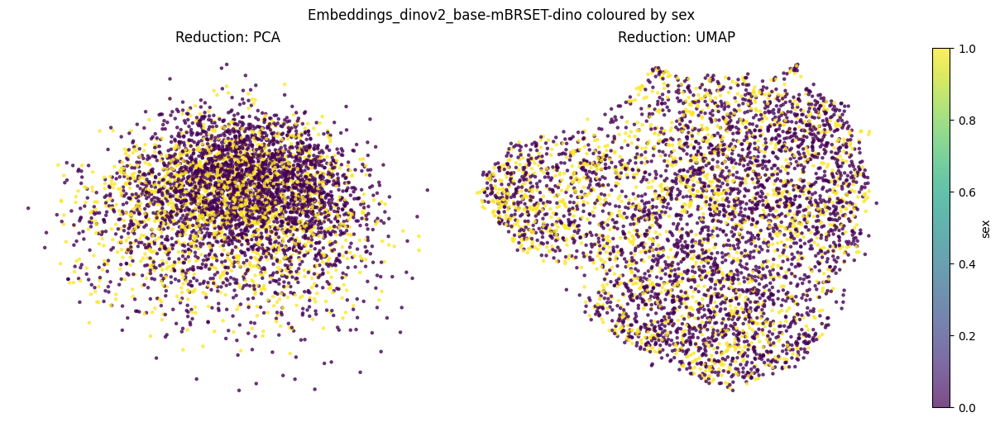

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


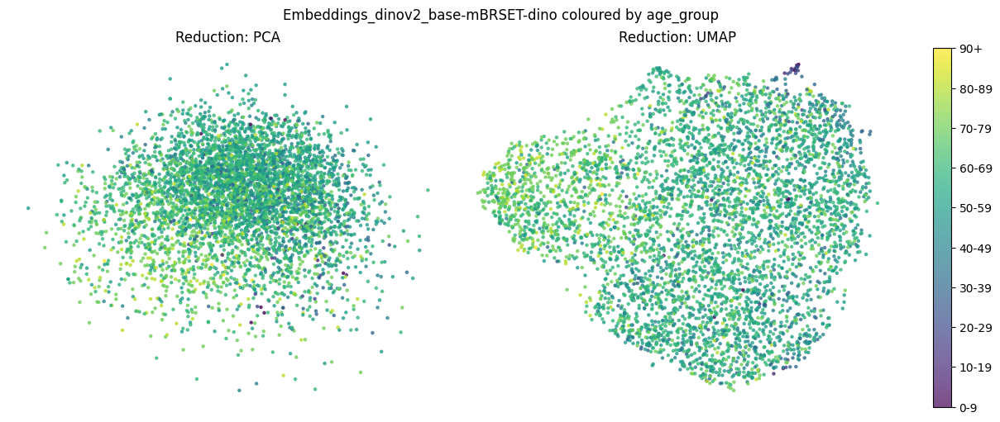

[I 2025-05-07 21:32:10,517] A new study created in memory with name: no-name-125f6bb3-1fd2-49f1-b550-b2663ca09f75
[I 2025-05-07 21:32:14,530] Trial 0 finished with value: 0.8655569782330346 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 0.0031966493404942033, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.8655569782330346.
[I 2025-05-07 21:32:18,509] Trial 1 finished with value: 0.8681177976952625 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.00034993479642030816, 'gamma': 3.0, 'batch_size': 128}. Best is trial 1 with value: 0.8681177976952625.
[I 2025-05-07 21:32:22,535] Trial 2 finished with value: 0.8706786171574904 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.0006270134292623161, 'gamma': 1.5, 'batch_size': 128}. Best is trial 2 with value: 0.8706786171574904.
[I 2025-05-07 21:32:26,518] Trial 3 finished with value: 0.8450704225352113 an

→ Best params for binary: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.00034011753365843875, 'gamma': 3.0, 'batch_size': 128}


[I 2025-05-07 21:34:44,665] A new study created in memory with name: no-name-1fb7fe48-c60f-432a-96e9-e58c38d90f9f


BINARY – Test acc=0.834, AUROC=0.856
              precision    recall  f1-score   support

           0      0.897     0.885     0.891       750
           1      0.637     0.665     0.651       227

    accuracy                          0.834       977
   macro avg      0.767     0.775     0.771       977
weighted avg      0.837     0.834     0.835       977



[I 2025-05-07 21:34:48,677] Trial 0 finished with value: 0.8463508322663252 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.0007511729877944073, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.8463508322663252.
[I 2025-05-07 21:34:55,319] Trial 1 finished with value: 0.8322663252240717 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.1, 'lr': 0.0009570581533257556, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.8463508322663252.
[I 2025-05-07 21:34:59,370] Trial 2 finished with value: 0.8425096030729834 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 9.9505802644332e-05, 'gamma': 2.5, 'batch_size': 128}. Best is trial 0 with value: 0.8463508322663252.
[I 2025-05-07 21:35:06,033] Trial 3 finished with value: 0.8066581306017926 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 3.5763543299494216e-05

→ Best params for 3class: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.00022175541879086515, 'gamma': 2.0, 'batch_size': 128}
3CLASS – Test acc=0.821, AUROC=0.866
              precision    recall  f1-score   support

           0      0.883     0.908     0.895       750
           1      0.545     0.524     0.534       185
           2      0.857     0.571     0.686        42

    accuracy                          0.821       977
   macro avg      0.762     0.668     0.705       977
weighted avg      0.818     0.821     0.818       977


=== Processing Embeddings_dinov2_base.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


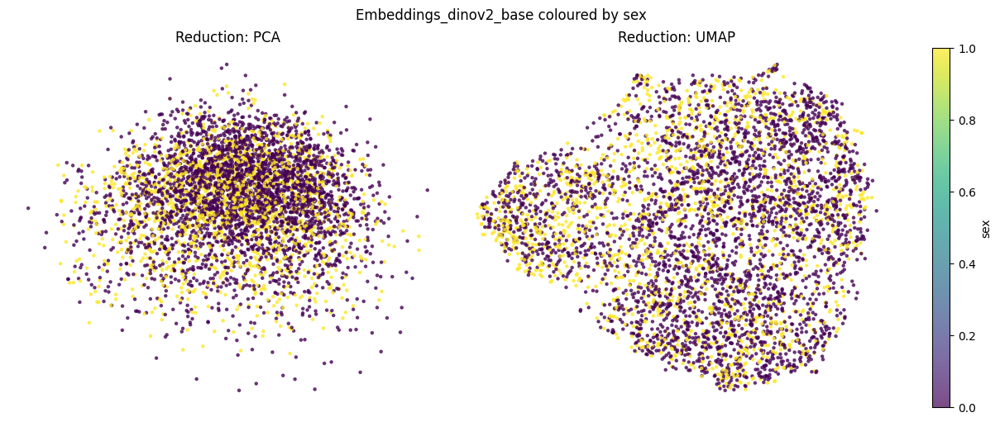

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


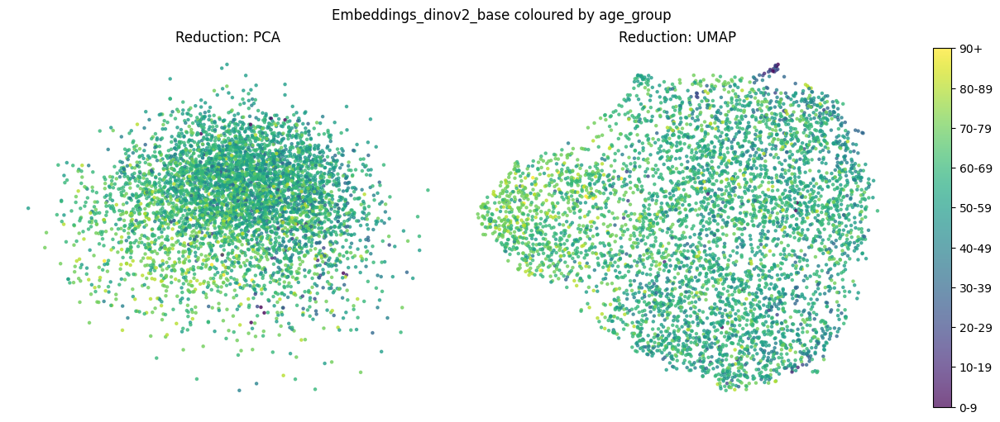

[I 2025-05-07 21:37:30,335] A new study created in memory with name: no-name-4d4f1bb4-61d1-48d9-a7cb-a14d3f1ec528
[I 2025-05-07 21:37:36,997] Trial 0 finished with value: 0.8565941101152369 and parameters: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.4, 'drop2': 0.5, 'lr': 0.0007706495461422296, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.8565941101152369.
[I 2025-05-07 21:37:43,637] Trial 1 finished with value: 0.8194622279129321 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 1.1449998471865285e-05, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.8565941101152369.
[I 2025-05-07 21:37:47,658] Trial 2 finished with value: 0.8719590268886044 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.2, 'lr': 0.00025074282028188124, 'gamma': 1.5, 'batch_size': 128}. Best is trial 2 with value: 0.8719590268886044.
[I 2025-05-07 21:37:51,705] Trial 3 finished with value: 0.8681

→ Best params for binary: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 0.0002549908127639414, 'gamma': 2.0, 'batch_size': 128}


[I 2025-05-07 21:39:57,143] A new study created in memory with name: no-name-d754ffec-834d-43ee-b980-34c3197e3a44


BINARY – Test acc=0.839, AUROC=0.855
              precision    recall  f1-score   support

           0      0.892     0.900     0.896       750
           1      0.659     0.639     0.649       227

    accuracy                          0.839       977
   macro avg      0.775     0.769     0.772       977
weighted avg      0.838     0.839     0.838       977



[I 2025-05-07 21:40:04,009] Trial 0 finished with value: 0.8450704225352113 and parameters: {'hidden1': 128, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.2, 'lr': 0.0028676477339835784, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.8450704225352113.
[I 2025-05-07 21:40:08,076] Trial 1 finished with value: 0.8373879641485276 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.4, 'drop2': 0.5, 'lr': 0.0004581980744242621, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.8450704225352113.
[I 2025-05-07 21:40:12,112] Trial 2 finished with value: 0.8463508322663252 and parameters: {'hidden1': 128, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 0.0020439579287984803, 'gamma': 2.5, 'batch_size': 128}. Best is trial 2 with value: 0.8463508322663252.
[I 2025-05-07 21:40:16,139] Trial 3 finished with value: 0.8425096030729834 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.4, 'drop2': 0.1, 'lr': 0.0057505827154463

→ Best params for 3class: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.1, 'lr': 0.001118328243576127, 'gamma': 3.0, 'batch_size': 64}
3CLASS – Test acc=0.819, AUROC=0.885
              precision    recall  f1-score   support

           0      0.887     0.900     0.893       750
           1      0.542     0.524     0.533       185
           2      0.757     0.667     0.709        42

    accuracy                          0.819       977
   macro avg      0.729     0.697     0.712       977
weighted avg      0.816     0.819     0.817       977


=== Processing Embeddings_vit_base-mBRSET-byol.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


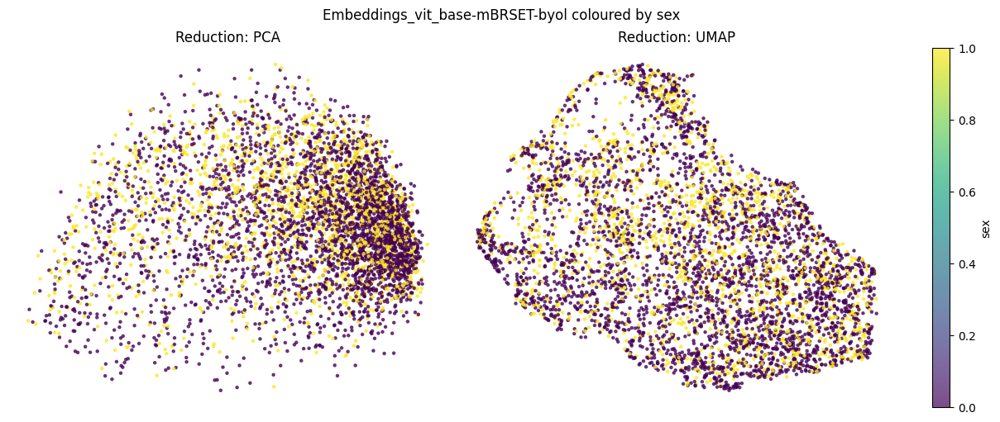

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


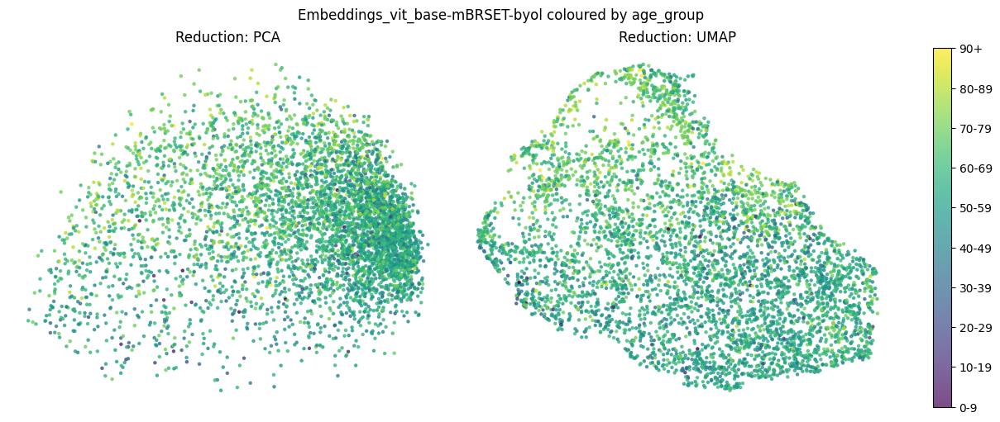

[I 2025-05-07 21:43:33,491] A new study created in memory with name: no-name-95b2981e-6926-40a9-aee4-16494ea02405
[I 2025-05-07 21:43:40,197] Trial 0 finished with value: 0.8117797695262484 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.1, 'lr': 0.000125019517577479, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.8117797695262484.
[I 2025-05-07 21:43:46,857] Trial 1 finished with value: 0.7759282970550576 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.4, 'drop2': 0.1, 'lr': 2.464487749217196e-05, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.8117797695262484.
[I 2025-05-07 21:43:53,558] Trial 2 finished with value: 0.7759282970550576 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.0010709231067423807, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.8117797695262484.
[I 2025-05-07 21:43:57,604] Trial 3 finished with value: 0.7964148527528809 and parameters: {'hidden

→ Best params for binary: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.1, 'lr': 0.000125019517577479, 'gamma': 2.0, 'batch_size': 64}


[I 2025-05-07 21:46:32,566] A new study created in memory with name: no-name-8ec790d3-72f1-48ab-8d8f-9bff3fcf1832


BINARY – Test acc=0.779, AUROC=0.778
              precision    recall  f1-score   support

           0      0.881     0.823     0.851       750
           1      0.520     0.634     0.571       227

    accuracy                          0.779       977
   macro avg      0.701     0.729     0.711       977
weighted avg      0.797     0.779     0.786       977



[I 2025-05-07 21:46:39,284] Trial 0 finished with value: 0.7528809218950064 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.5, 'drop2': 0.2, 'lr': 0.00030260681797073435, 'gamma': 1.5, 'batch_size': 64}. Best is trial 0 with value: 0.7528809218950064.
[I 2025-05-07 21:46:46,035] Trial 1 finished with value: 0.7682458386683739 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.2, 'lr': 0.004292498519634205, 'gamma': 3.0, 'batch_size': 64}. Best is trial 1 with value: 0.7682458386683739.
[I 2025-05-07 21:46:50,136] Trial 2 finished with value: 0.764404609475032 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.5, 'lr': 0.0006702511441710152, 'gamma': 1.5, 'batch_size': 128}. Best is trial 1 with value: 0.7682458386683739.
[I 2025-05-07 21:46:56,876] Trial 3 finished with value: 0.7720870678617158 and parameters: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.2, 'lr': 0.00316957443112706, 'gamma': 2.5, 'b

→ Best params for 3class: {'hidden1': 384, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.4, 'lr': 0.0001728058742307032, 'gamma': 2.0, 'batch_size': 64}
3CLASS – Test acc=0.767, AUROC=0.801
              precision    recall  f1-score   support

           0      0.866     0.859     0.862       750
           1      0.422     0.438     0.430       185
           2      0.585     0.571     0.578        42

    accuracy                          0.767       977
   macro avg      0.624     0.623     0.623       977
weighted avg      0.770     0.767     0.768       977


=== Processing Embeddings_vit_base-mBRSET-contrastive.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


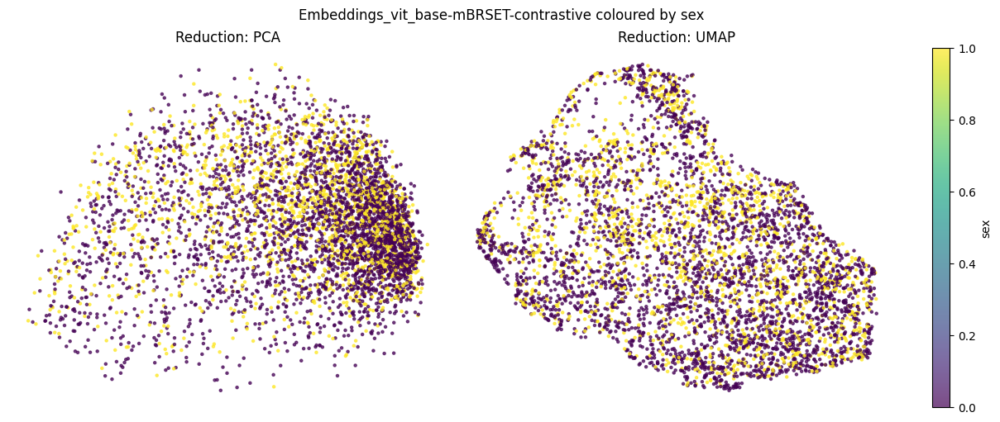

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


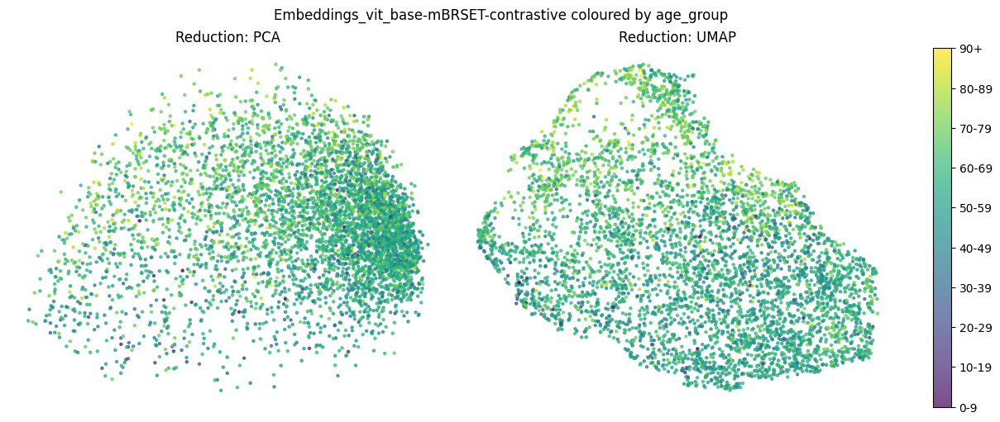

[I 2025-05-07 21:50:10,478] A new study created in memory with name: no-name-b21dd700-ad9d-423f-a482-43328d475d4c
[I 2025-05-07 21:50:16,885] Trial 0 finished with value: 0.7490396927016645 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 1.686883441361989e-05, 'gamma': 3.0, 'batch_size': 64}. Best is trial 0 with value: 0.7490396927016645.
[I 2025-05-07 21:50:20,432] Trial 1 finished with value: 0.7912932138284251 and parameters: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 0.00039320355431757145, 'gamma': 2.5, 'batch_size': 128}. Best is trial 1 with value: 0.7912932138284251.
[I 2025-05-07 21:50:24,287] Trial 2 finished with value: 0.7900128040973111 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 9.316249475496792e-05, 'gamma': 3.0, 'batch_size': 128}. Best is trial 1 with value: 0.7912932138284251.
[I 2025-05-07 21:50:28,365] Trial 3 finished wi

→ Best params for binary: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.4, 'lr': 0.00018394919123998049, 'gamma': 1.0, 'batch_size': 64}


[I 2025-05-07 21:52:54,478] A new study created in memory with name: no-name-98a07013-0553-4ff0-9449-a9c7777f2a62


BINARY – Test acc=0.791, AUROC=0.769
              precision    recall  f1-score   support

           0      0.867     0.860     0.863       750
           1      0.549     0.564     0.557       227

    accuracy                          0.791       977
   macro avg      0.708     0.712     0.710       977
weighted avg      0.793     0.791     0.792       977



[I 2025-05-07 21:52:58,522] Trial 0 finished with value: 0.7580025608194623 and parameters: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.4, 'drop2': 0.5, 'lr': 0.00029875384621357015, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.7580025608194623.
[I 2025-05-07 21:53:05,296] Trial 1 finished with value: 0.7554417413572343 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.5, 'drop2': 0.4, 'lr': 0.0006590896066632584, 'gamma': 1.5, 'batch_size': 64}. Best is trial 0 with value: 0.7580025608194623.
[I 2025-05-07 21:53:09,339] Trial 2 finished with value: 0.7874519846350833 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.5, 'drop2': 0.2, 'lr': 0.0014228280093298111, 'gamma': 3.0, 'batch_size': 128}. Best is trial 2 with value: 0.7874519846350833.
[I 2025-05-07 21:53:13,375] Trial 3 finished with value: 0.7618437900128041 and parameters: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.5, 'lr': 0.0003052512644012952, 'gamma': 1

→ Best params for 3class: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.1, 'lr': 0.009091363911411887, 'gamma': 3.0, 'batch_size': 64}
3CLASS – Test acc=0.620, AUROC=0.809
              precision    recall  f1-score   support

           0      0.882     0.620     0.728       750
           1      0.290     0.638     0.399       185
           2      0.535     0.548     0.541        42

    accuracy                          0.620       977
   macro avg      0.569     0.602     0.556       977
weighted avg      0.755     0.620     0.658       977


=== Processing Embeddings_vit_base-mBRSET-dino.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


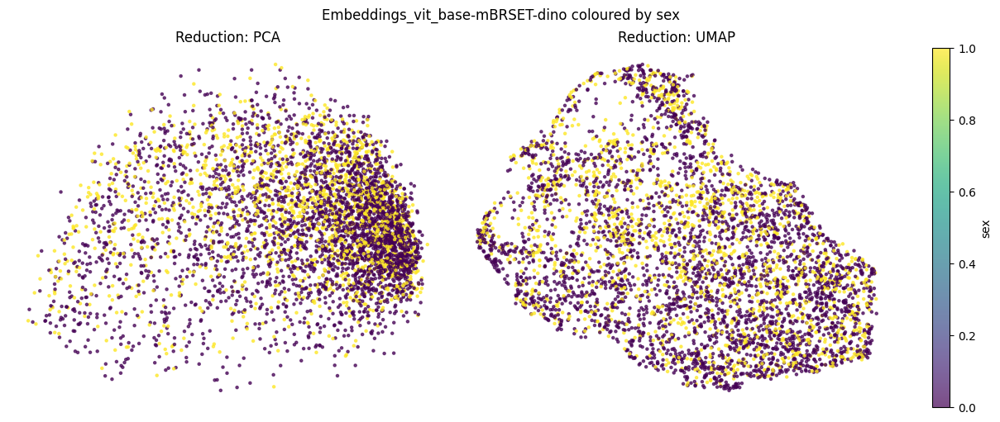

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


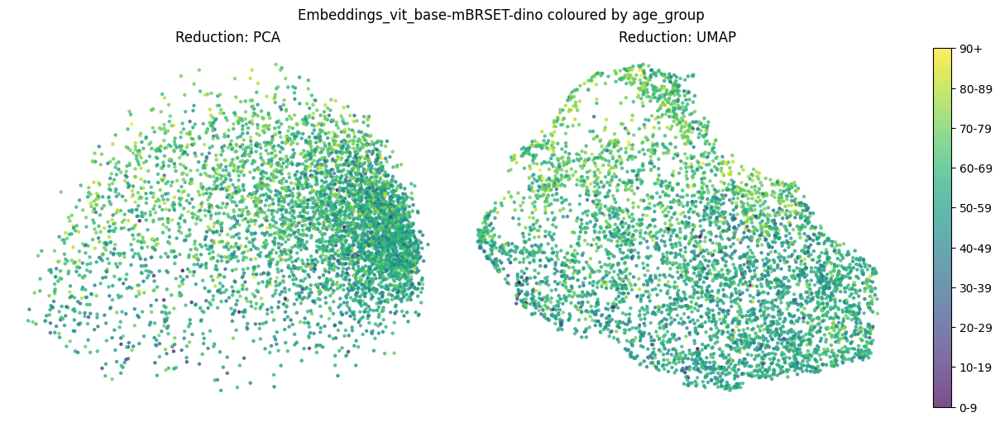

[I 2025-05-07 21:56:30,595] A new study created in memory with name: no-name-fbae444c-f602-4b09-93aa-8451657e39fc
[I 2025-05-07 21:56:34,718] Trial 0 finished with value: 0.793854033290653 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.4, 'lr': 0.0036885764304788763, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.793854033290653.
[I 2025-05-07 21:56:41,480] Trial 1 finished with value: 0.7836107554417413 and parameters: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 0.007238453811251794, 'gamma': 3.0, 'batch_size': 64}. Best is trial 0 with value: 0.793854033290653.
[I 2025-05-07 21:56:48,239] Trial 2 finished with value: 0.7669654289372599 and parameters: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.4, 'drop2': 0.5, 'lr': 0.00016025849488669825, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.793854033290653.
[I 2025-05-07 21:56:52,419] Trial 3 finished with value: 0.775928297

→ Best params for binary: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.0011109679337458125, 'gamma': 1.5, 'batch_size': 64}


[I 2025-05-07 21:59:41,454] A new study created in memory with name: no-name-b093937c-7447-44de-960f-682fd95a4df5


BINARY – Test acc=0.781, AUROC=0.777
              precision    recall  f1-score   support

           0      0.871     0.839     0.855       750
           1      0.525     0.590     0.556       227

    accuracy                          0.781       977
   macro avg      0.698     0.714     0.705       977
weighted avg      0.791     0.781     0.785       977



[I 2025-05-07 21:59:48,134] Trial 0 finished with value: 0.7503201024327785 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.1, 'lr': 5.8242211125853605e-05, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.7503201024327785.
[I 2025-05-07 21:59:52,179] Trial 1 finished with value: 0.7592829705505761 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.1, 'lr': 0.000175509820718313, 'gamma': 1.0, 'batch_size': 128}. Best is trial 1 with value: 0.7592829705505761.
[I 2025-05-07 21:59:58,916] Trial 2 finished with value: 0.7516005121638925 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.2, 'lr': 9.898614585984954e-05, 'gamma': 2.0, 'batch_size': 64}. Best is trial 1 with value: 0.7592829705505761.
[I 2025-05-07 22:00:02,964] Trial 3 finished with value: 0.7784891165172856 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.00012181703444807432, 'gamma': 3.0,

→ Best params for 3class: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.00017115459410576043, 'gamma': 3.0, 'batch_size': 128}
3CLASS – Test acc=0.772, AUROC=0.817
              precision    recall  f1-score   support

           0      0.877     0.845     0.861       750
           1      0.443     0.524     0.480       185
           2      0.657     0.548     0.597        42

    accuracy                          0.772       977
   macro avg      0.659     0.639     0.646       977
weighted avg      0.785     0.772     0.777       977


=== Processing Embeddings_vit_base.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


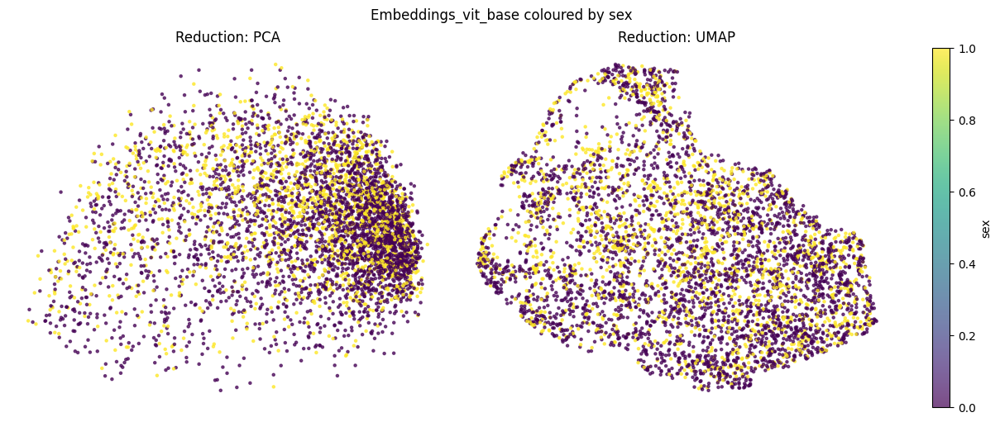

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


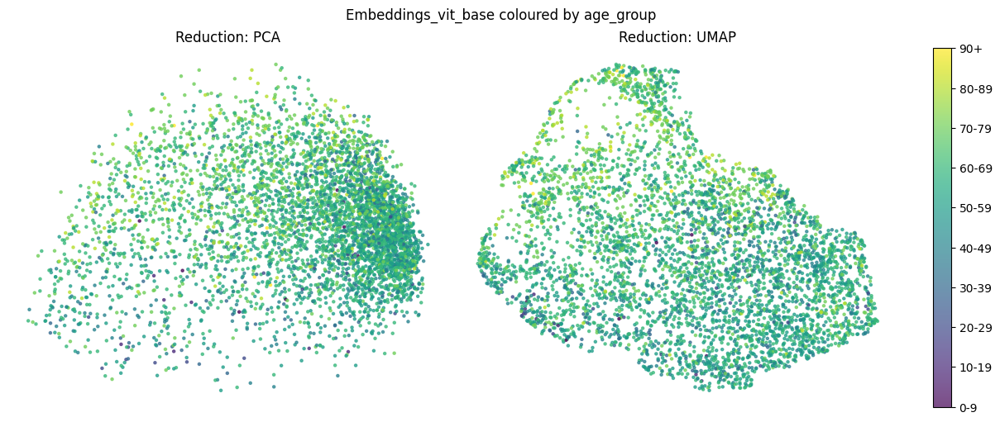

[I 2025-05-07 22:02:48,857] A new study created in memory with name: no-name-60b8cbd4-a505-4f20-9871-c81abf1271d7
[I 2025-05-07 22:02:52,968] Trial 0 finished with value: 0.7695262483994878 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.5, 'drop2': 0.2, 'lr': 2.1280438770517054e-05, 'gamma': 1.0, 'batch_size': 128}. Best is trial 0 with value: 0.7695262483994878.
[I 2025-05-07 22:02:57,062] Trial 1 finished with value: 0.7682458386683739 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.5, 'drop2': 0.5, 'lr': 0.0001661507872440246, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.7695262483994878.
[I 2025-05-07 22:03:03,813] Trial 2 finished with value: 0.7720870678617158 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.005469498284484348, 'gamma': 1.0, 'batch_size': 64}. Best is trial 2 with value: 0.7720870678617158.
[I 2025-05-07 22:03:10,587] Trial 3 finished with value: 0.7836107554417413 and parameters: {'h

→ Best params for binary: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.4, 'drop2': 0.2, 'lr': 0.0004604109956955897, 'gamma': 2.0, 'batch_size': 128}


[I 2025-05-07 22:05:52,308] A new study created in memory with name: no-name-84772a2f-11f7-42af-a0f5-ad86bb9a9a67


BINARY – Test acc=0.772, AUROC=0.770
              precision    recall  f1-score   support

           0      0.871     0.825     0.847       750
           1      0.508     0.595     0.548       227

    accuracy                          0.772       977
   macro avg      0.689     0.710     0.698       977
weighted avg      0.786     0.772     0.778       977



[I 2025-05-07 22:05:59,058] Trial 0 finished with value: 0.7567221510883483 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.4, 'lr': 0.008919541873869933, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.7567221510883483.
[I 2025-05-07 22:06:03,114] Trial 1 finished with value: 0.7426376440460948 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.1, 'lr': 0.002394360696573353, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.7567221510883483.
[I 2025-05-07 22:06:09,789] Trial 2 finished with value: 0.7618437900128041 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.2, 'drop2': 0.5, 'lr': 0.00010700454486546763, 'gamma': 2.5, 'batch_size': 64}. Best is trial 2 with value: 0.7618437900128041.
[I 2025-05-07 22:06:16,576] Trial 3 finished with value: 0.7631241997439181 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.4, 'lr': 0.0003692881839999695, 'gamma': 1.0, '

→ Best params for 3class: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.00013485815637908873, 'gamma': 2.0, 'batch_size': 128}
3CLASS – Test acc=0.796, AUROC=0.810
              precision    recall  f1-score   support

           0      0.859     0.904     0.881       750
           1      0.497     0.405     0.446       185
           2      0.676     0.595     0.633        42

    accuracy                          0.796       977
   macro avg      0.677     0.635     0.653       977
weighted avg      0.783     0.796     0.788       977


=== Processing Embeddings_convnextv2_base-BRSET-byol.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


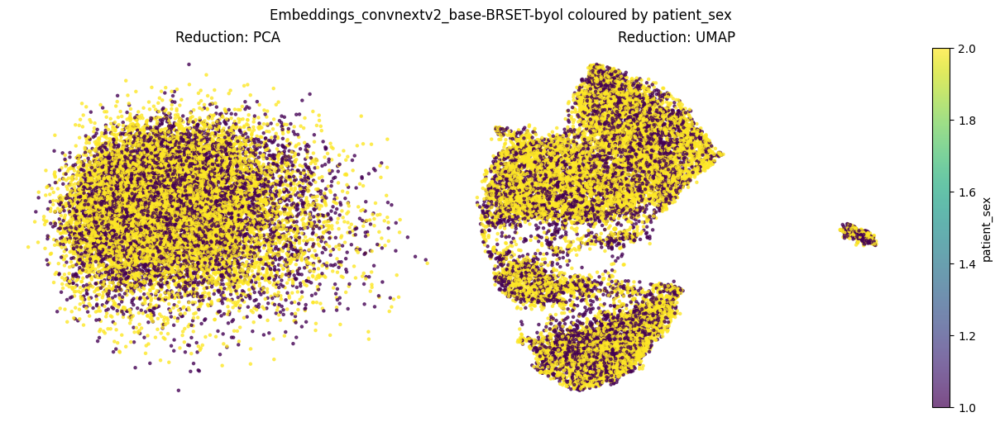

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


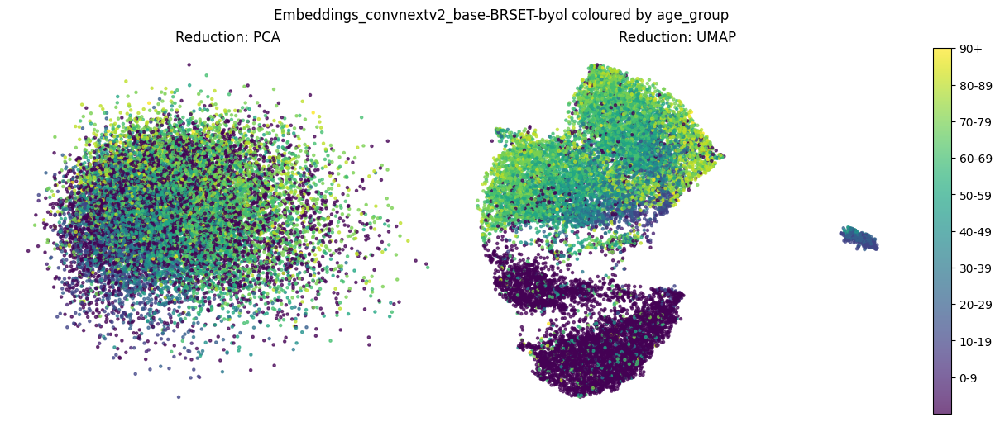

[I 2025-05-07 22:09:43,805] A new study created in memory with name: no-name-c76d4619-5be2-4dd2-bae7-d74471ca1fb7
[I 2025-05-07 22:10:06,266] Trial 0 finished with value: 0.9342813220599538 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.30000000000000004, 'drop2': 0.5, 'lr': 0.00023595058111069634, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.9342813220599538.
[I 2025-05-07 22:10:28,772] Trial 1 finished with value: 0.9431206764027671 and parameters: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.5, 'lr': 0.0038963285931572123, 'gamma': 2.0, 'batch_size': 64}. Best is trial 1 with value: 0.9431206764027671.
[I 2025-05-07 22:10:51,130] Trial 2 finished with value: 0.936587240584166 and parameters: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.4, 'drop2': 0.1, 'lr': 2.013915844459437e-05, 'gamma': 3.0, 'batch_size': 64}. Best is trial 1 with value: 0.9431206764027671.
[I 2025-05-07 22:11:13,327] Trial 3 finished with value: 0.9538816295157571 and pa

→ Best params for binary: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.1, 'lr': 3.889124199745934e-05, 'gamma': 2.5, 'batch_size': 128}
BINARY – Test acc=0.954, AUROC=0.918
              precision    recall  f1-score   support

           0      0.980     0.970     0.975      3043
           1      0.624     0.716     0.667       211

    accuracy                          0.954      3254
   macro avg      0.802     0.843     0.821      3254
weighted avg      0.957     0.954     0.955      3254



[I 2025-05-07 22:17:54,319] A new study created in memory with name: no-name-fe7945a3-34c9-4492-be4a-e3a1ab2042f4
[I 2025-05-07 22:18:07,490] Trial 0 finished with value: 0.9369715603382014 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.5, 'lr': 3.758122561841488e-05, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.9369715603382014.
[I 2025-05-07 22:18:29,754] Trial 1 finished with value: 0.9269792467332821 and parameters: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.2, 'lr': 0.008708047602016707, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.9369715603382014.
[I 2025-05-07 22:18:42,946] Trial 2 finished with value: 0.9362029208301307 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 0.00014809914319487705, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.9369715603382014.
[I 2025-05-07 22:18:56,063] Trial 3 finished with value: 0.91083

→ Best params for 3class: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 0.0004724086284969926, 'gamma': 1.5, 'batch_size': 64}
3CLASS – Test acc=0.951, AUROC=0.927
              precision    recall  f1-score   support

           0      0.977     0.978     0.978      3043
           1      0.507     0.515     0.511       132
           2      0.671     0.620     0.645        79

    accuracy                          0.951      3254
   macro avg      0.719     0.705     0.711      3254
weighted avg      0.951     0.951     0.951      3254


=== Processing Embeddings_convnextv2_base-BRSET-contrastive.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


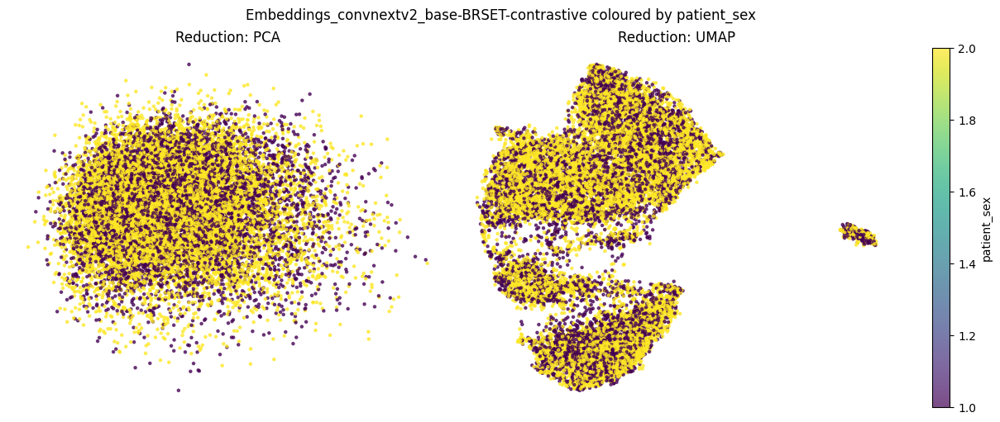

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


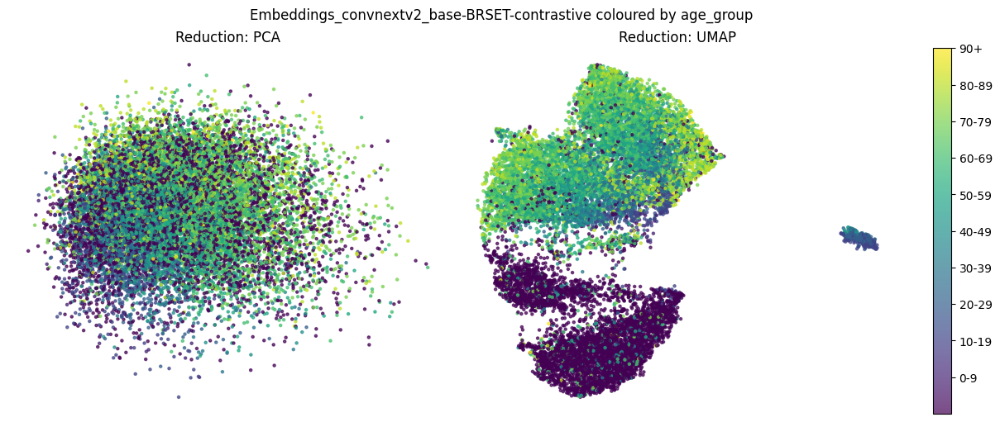

[I 2025-05-07 22:28:59,782] A new study created in memory with name: no-name-a2c7eeff-5b92-4de4-8bdf-d2e205cc43b0
[I 2025-05-07 22:29:21,698] Trial 0 finished with value: 0.9558032282859339 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.0012158059117990726, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.9558032282859339.
[I 2025-05-07 22:29:34,712] Trial 1 finished with value: 0.9442736356648732 and parameters: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.4, 'drop2': 0.5, 'lr': 0.0006164410098803024, 'gamma': 1.5, 'batch_size': 128}. Best is trial 0 with value: 0.9558032282859339.
[I 2025-05-07 22:29:56,710] Trial 2 finished with value: 0.9558032282859339 and parameters: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 3.407923607907332e-05, 'gamma': 1.5, 'batch_size': 64}. Best is trial 0 with value: 0.9558032282859339.
[I 2025-05-07 22:30:09,770] Trial 3 finished with value: 0.9442736356648732 and 

→ Best params for binary: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.0016043785016036356, 'gamma': 2.5, 'batch_size': 64}
BINARY – Test acc=0.945, AUROC=0.926
              precision    recall  f1-score   support

           0      0.981     0.960     0.970      3043
           1      0.558     0.730     0.632       211

    accuracy                          0.945      3254
   macro avg      0.769     0.845     0.801      3254
weighted avg      0.953     0.945     0.948      3254



[I 2025-05-07 22:37:51,338] A new study created in memory with name: no-name-5af12671-1d3e-4551-b970-3be56caa0f54
[I 2025-05-07 22:38:04,493] Trial 0 finished with value: 0.9454265949269792 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 6.141340507788113e-05, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.9454265949269792.
[I 2025-05-07 22:38:17,597] Trial 1 finished with value: 0.9469638739431206 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.4, 'drop2': 0.30000000000000004, 'lr': 0.0006652891041891668, 'gamma': 2.0, 'batch_size': 128}. Best is trial 1 with value: 0.9469638739431206.
[I 2025-05-07 22:38:39,509] Trial 2 finished with value: 0.9369715603382014 and parameters: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.4, 'drop2': 0.4, 'lr': 0.00011777043319573936, 'gamma': 1.5, 'batch_size': 64}. Best is trial 1 with value: 0.9469638739431206.
[I 2025-05-07 22:38:52,523] Trial 3 finished with value: 0.94888

→ Best params for 3class: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.2, 'drop2': 0.1, 'lr': 6.240553461812052e-05, 'gamma': 2.0, 'batch_size': 64}
3CLASS – Test acc=0.937, AUROC=0.926
              precision    recall  f1-score   support

           0      0.982     0.959     0.970      3043
           1      0.388     0.576     0.463       132
           2      0.643     0.684     0.663        79

    accuracy                          0.937      3254
   macro avg      0.671     0.740     0.699      3254
weighted avg      0.949     0.937     0.942      3254


=== Processing Embeddings_convnextv2_base-BRSET-dino.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


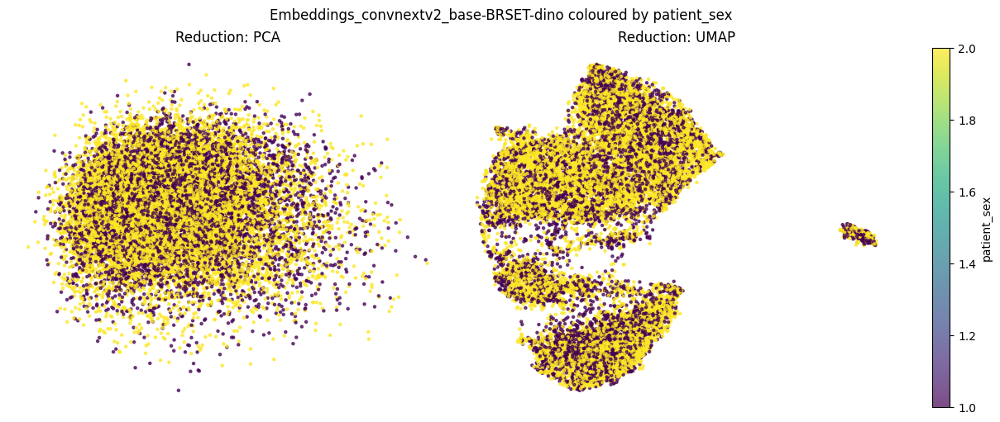

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


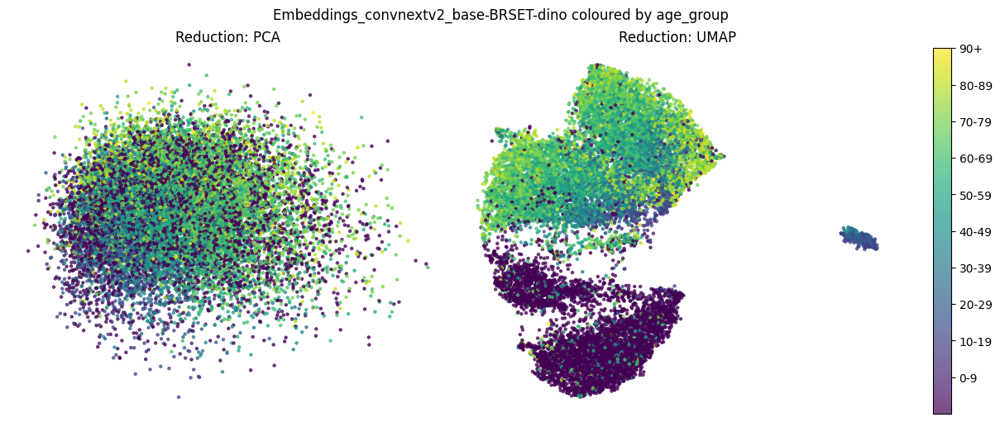

[I 2025-05-07 22:46:50,164] A new study created in memory with name: no-name-6c285317-5241-4614-8973-d895622000a9
[I 2025-05-07 22:47:03,465] Trial 0 finished with value: 0.9504227517294389 and parameters: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.2, 'drop2': 0.1, 'lr': 2.913366206472451e-05, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.9504227517294389.
[I 2025-05-07 22:47:25,572] Trial 1 finished with value: 0.9177555726364335 and parameters: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 0.00010697876182703462, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.9504227517294389.
[I 2025-05-07 22:47:47,698] Trial 2 finished with value: 0.9469638739431206 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.30000000000000004, 'lr': 0.000553553375869191, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.9504227517294389.
[I 2025-05-07 22:48:00,873] Trial 3 finished wit

→ Best params for binary: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.0013237202001705273, 'gamma': 1.0, 'batch_size': 128}
BINARY – Test acc=0.934, AUROC=0.921
              precision    recall  f1-score   support

           0      0.982     0.947     0.964      3043
           1      0.495     0.744     0.595       211

    accuracy                          0.934      3254
   macro avg      0.738     0.846     0.779      3254
weighted avg      0.950     0.934     0.940      3254



[I 2025-05-07 22:54:57,205] A new study created in memory with name: no-name-254403ac-b1a9-4cc0-989a-146e0fb365ef
[I 2025-05-07 22:55:19,800] Trial 0 finished with value: 0.9438893159108378 and parameters: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.2, 'lr': 0.0004986346696448528, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.9438893159108378.
[I 2025-05-07 22:55:41,781] Trial 1 finished with value: 0.9273635664873174 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.30000000000000004, 'lr': 0.004193857148418693, 'gamma': 3.0, 'batch_size': 64}. Best is trial 0 with value: 0.9438893159108378.
[I 2025-05-07 22:55:54,841] Trial 2 finished with value: 0.9442736356648732 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.4, 'lr': 0.0012465950111783173, 'gamma': 2.5, 'batch_size': 128}. Best is trial 2 with value: 0.9442736356648732.
[I 2025-05-07 22:56:16,842] Trial 3 finished with value: 0.926979

→ Best params for 3class: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.00014767802799152454, 'gamma': 1.0, 'batch_size': 128}
3CLASS – Test acc=0.947, AUROC=0.921
              precision    recall  f1-score   support

           0      0.979     0.973     0.976      3043
           1      0.483     0.553     0.516       132
           2      0.590     0.582     0.586        79

    accuracy                          0.947      3254
   macro avg      0.684     0.703     0.693      3254
weighted avg      0.949     0.947     0.948      3254


=== Processing Embeddings_convnextv2_base.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


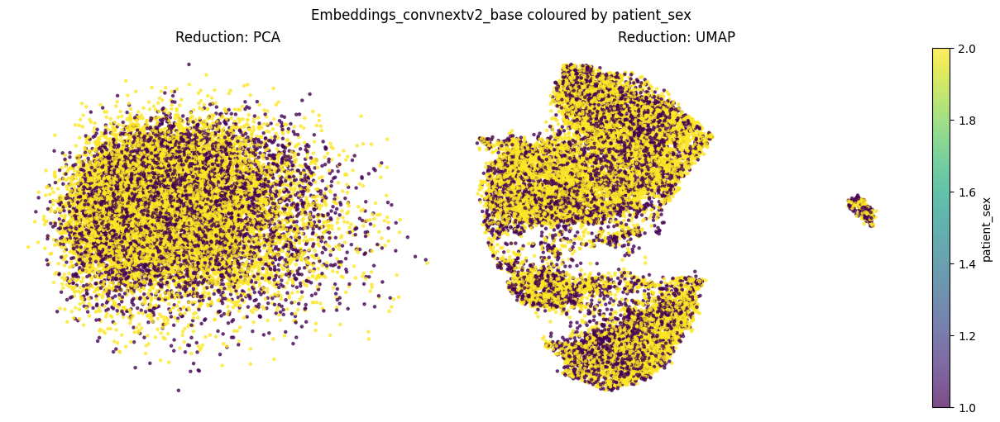

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


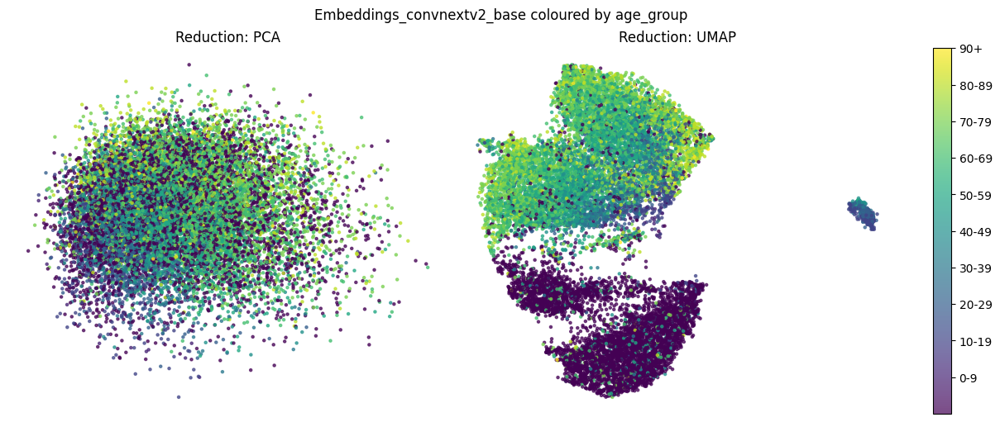

[I 2025-05-07 23:03:27,468] A new study created in memory with name: no-name-6c01e5f3-258e-4e03-b00e-fa2cb732d76f
[I 2025-05-07 23:03:49,538] Trial 0 finished with value: 0.9615680245964643 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 8.24855247986251e-05, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.9615680245964643.
[I 2025-05-07 23:04:11,488] Trial 1 finished with value: 0.9396617986164489 and parameters: {'hidden1': 128, 'hidden2': 256, 'drop1': 0.1, 'drop2': 0.4, 'lr': 1.3596449612609847e-05, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.9615680245964643.
[I 2025-05-07 23:04:33,505] Trial 2 finished with value: 0.95695618754804 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.2, 'lr': 4.191842807023952e-05, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.9615680245964643.
[I 2025-05-07 23:04:55,418] Trial 3 finished with value: 0.9415833973866257 and par

→ Best params for binary: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 8.24855247986251e-05, 'gamma': 2.0, 'batch_size': 64}
BINARY – Test acc=0.947, AUROC=0.935
              precision    recall  f1-score   support

           0      0.983     0.960     0.971      3043
           1      0.566     0.754     0.646       211

    accuracy                          0.947      3254
   macro avg      0.774     0.857     0.809      3254
weighted avg      0.955     0.947     0.950      3254



[I 2025-05-07 23:13:56,594] A new study created in memory with name: no-name-58036262-d231-4473-a525-f7c7210643c3
[I 2025-05-07 23:14:09,772] Trial 0 finished with value: 0.9496541122213682 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.000514352512862767, 'gamma': 2.5, 'batch_size': 128}. Best is trial 0 with value: 0.9496541122213682.
[I 2025-05-07 23:14:22,869] Trial 1 finished with value: 0.9427363566487318 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.5, 'lr': 0.0030297488401269785, 'gamma': 1.5, 'batch_size': 128}. Best is trial 0 with value: 0.9496541122213682.
[I 2025-05-07 23:14:36,030] Trial 2 finished with value: 0.9350499615680246 and parameters: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.4, 'drop2': 0.1, 'lr': 0.0035101677834835747, 'gamma': 2.5, 'batch_size': 128}. Best is trial 0 with value: 0.9496541122213682.
[I 2025-05-07 23:14:58,027] Trial 3 finished with value: 0.9388931591083781 and parameters: {'hi

→ Best params for 3class: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.1, 'lr': 4.548224243553456e-05, 'gamma': 1.0, 'batch_size': 64}
3CLASS – Test acc=0.950, AUROC=0.925
              precision    recall  f1-score   support

           0      0.980     0.975     0.978      3043
           1      0.483     0.545     0.512       132
           2      0.671     0.646     0.658        79

    accuracy                          0.950      3254
   macro avg      0.711     0.722     0.716      3254
weighted avg      0.952     0.950     0.951      3254


=== Processing Embeddings_dinov2_base-BRSET-byol.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


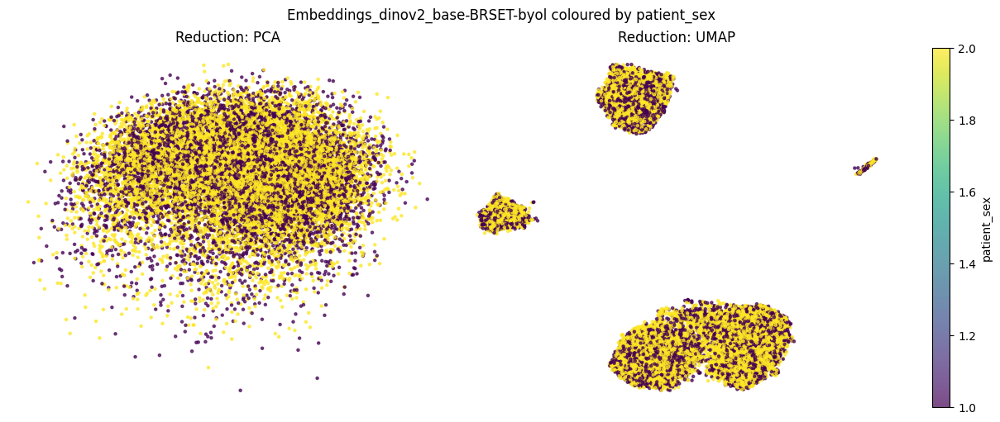

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


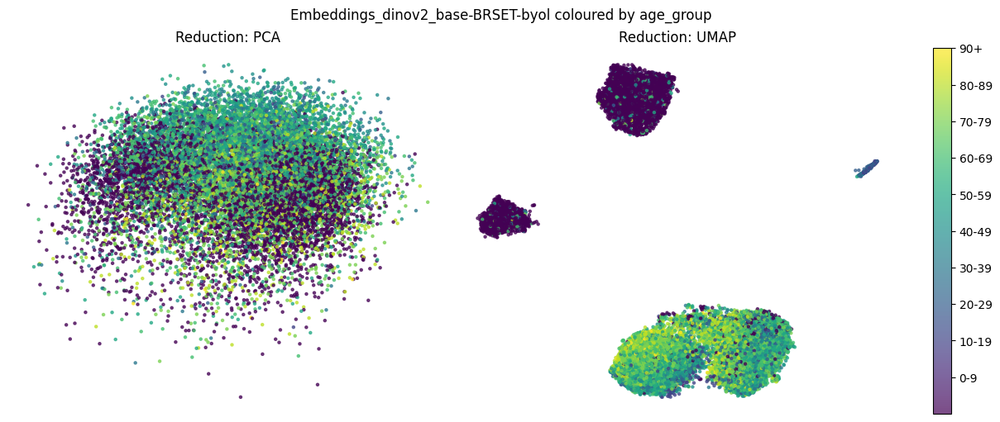

[I 2025-05-07 23:23:18,478] A new study created in memory with name: no-name-9e4f8c55-87e3-4957-9bda-2e369ef35126
[I 2025-05-07 23:23:40,263] Trial 0 finished with value: 0.9546502690238279 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 0.0003728186608646871, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.9546502690238279.
[I 2025-05-07 23:23:53,263] Trial 1 finished with value: 0.9561875480399693 and parameters: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.5, 'lr': 0.0038869551380075126, 'gamma': 1.0, 'batch_size': 128}. Best is trial 1 with value: 0.9561875480399693.
[I 2025-05-07 23:24:15,241] Trial 2 finished with value: 0.9542659492697925 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.2, 'drop2': 0.5, 'lr': 0.00016571668663142283, 'gamma': 1.5, 'batch_size': 64}. Best is trial 1 with value: 0.9561875480399693.
[I 2025-05-07 23:24:36,994] Trial 3 finished with value: 0.930822

→ Best params for binary: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.009404225937501199, 'gamma': 1.5, 'batch_size': 128}


[I 2025-05-07 23:31:02,935] A new study created in memory with name: no-name-3f050699-3c98-46a2-acc3-2eea1af89490


BINARY – Test acc=0.959, AUROC=0.940
              precision    recall  f1-score   support

           0      0.981     0.976     0.978      3043
           1      0.673     0.720     0.696       211

    accuracy                          0.959      3254
   macro avg      0.827     0.848     0.837      3254
weighted avg      0.961     0.959     0.960      3254



[I 2025-05-07 23:31:15,942] Trial 0 finished with value: 0.9035357417371253 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 1.130052589642707e-05, 'gamma': 2.5, 'batch_size': 128}. Best is trial 0 with value: 0.9035357417371253.
[I 2025-05-07 23:31:28,970] Trial 1 finished with value: 0.9000768639508071 and parameters: {'hidden1': 384, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.2, 'lr': 4.1436671509447685e-05, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.9035357417371253.
[I 2025-05-07 23:31:51,036] Trial 2 finished with value: 0.9296694850115296 and parameters: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.5, 'drop2': 0.4, 'lr': 0.0002317102799661446, 'gamma': 2.0, 'batch_size': 64}. Best is trial 2 with value: 0.9296694850115296.
[I 2025-05-07 23:32:13,001] Trial 3 finished with value: 0.9450422751729439 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.2, 'drop2': 0.30000000000000004, 'lr': 0.0004585866518895

→ Best params for 3class: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.2, 'lr': 8.980483625849897e-05, 'gamma': 1.0, 'batch_size': 64}
3CLASS – Test acc=0.948, AUROC=0.930
              precision    recall  f1-score   support

           0      0.980     0.972     0.976      3043
           1      0.458     0.538     0.495       132
           2      0.691     0.709     0.700        79

    accuracy                          0.948      3254
   macro avg      0.710     0.739     0.724      3254
weighted avg      0.952     0.948     0.950      3254


=== Processing Embeddings_dinov2_base-BRSET-contrastive.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


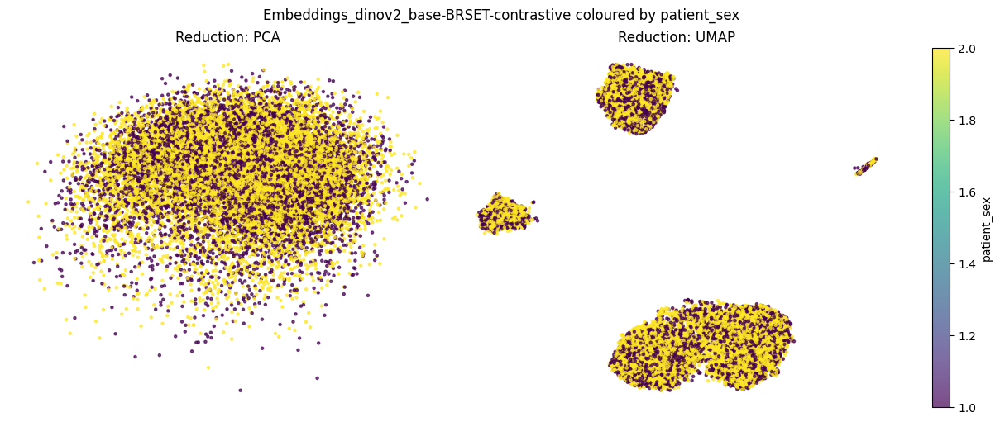

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


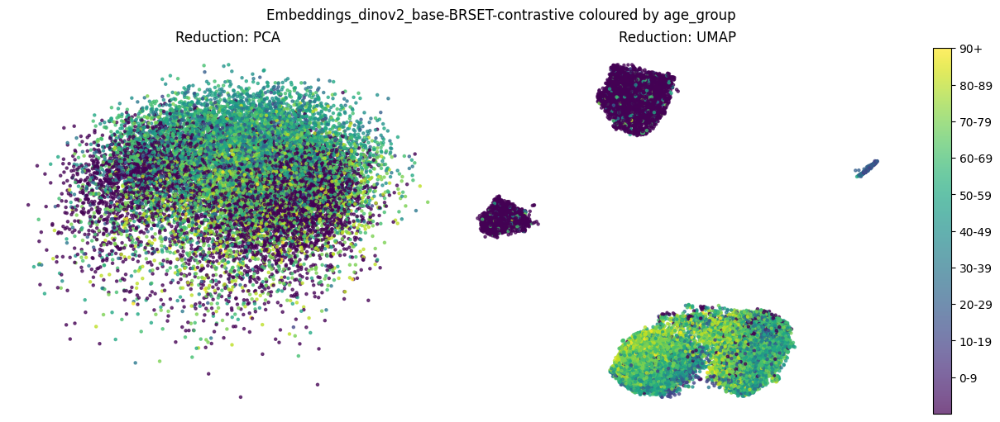

[I 2025-05-07 23:41:59,570] A new study created in memory with name: no-name-49afd041-5973-471f-b348-165f799eb203
[I 2025-05-07 23:42:12,504] Trial 0 finished with value: 0.9465795541890853 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.1, 'lr': 0.0036950669841124546, 'gamma': 1.0, 'batch_size': 128}. Best is trial 0 with value: 0.9465795541890853.
[I 2025-05-07 23:42:25,475] Trial 1 finished with value: 0.9446579554189085 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.4, 'drop2': 0.4, 'lr': 0.0005600969898918056, 'gamma': 2.5, 'batch_size': 128}. Best is trial 0 with value: 0.9465795541890853.
[I 2025-05-07 23:42:38,460] Trial 2 finished with value: 0.9592621060722522 and parameters: {'hidden1': 384, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 0.00031591986425914803, 'gamma': 2.0, 'batch_size': 128}. Best is trial 2 with value: 0.9592621060722522.
[I 2025-05-07 23:43:00,260] Trial 3 finished with value: 0.9415833973866257 and

→ Best params for binary: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.0001015025346701361, 'gamma': 1.5, 'batch_size': 128}


[I 2025-05-07 23:49:32,538] A new study created in memory with name: no-name-4d4e0393-d327-4340-88be-2ed180610fe4


BINARY – Test acc=0.959, AUROC=0.942
              precision    recall  f1-score   support

           0      0.980     0.976     0.978      3043
           1      0.676     0.711     0.693       211

    accuracy                          0.959      3254
   macro avg      0.828     0.844     0.835      3254
weighted avg      0.960     0.959     0.960      3254



[I 2025-05-07 23:49:54,319] Trial 0 finished with value: 0.940814757878555 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.2, 'drop2': 0.5, 'lr': 3.7120207649113064e-05, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.940814757878555.
[I 2025-05-07 23:50:16,355] Trial 1 finished with value: 0.9561875480399693 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.0011426626903088257, 'gamma': 1.5, 'batch_size': 64}. Best is trial 1 with value: 0.9561875480399693.
[I 2025-05-07 23:50:29,303] Trial 2 finished with value: 0.9346656418139893 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.4, 'drop2': 0.2, 'lr': 0.0002457135436513055, 'gamma': 1.0, 'batch_size': 128}. Best is trial 1 with value: 0.9561875480399693.
[I 2025-05-07 23:50:50,965] Trial 3 finished with value: 0.9323597232897771 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.5, 'lr': 0.00029772978193711504, 'gamma': 3.0, 'batch_size': 6

→ Best params for 3class: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.0011426626903088257, 'gamma': 1.5, 'batch_size': 64}
3CLASS – Test acc=0.941, AUROC=0.948
              precision    recall  f1-score   support

           0      0.981     0.965     0.972      3043
           1      0.415     0.576     0.483       132
           2      0.654     0.646     0.650        79

    accuracy                          0.941      3254
   macro avg      0.683     0.729     0.702      3254
weighted avg      0.950     0.941     0.945      3254


=== Processing Embeddings_dinov2_base-BRSET-dino.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


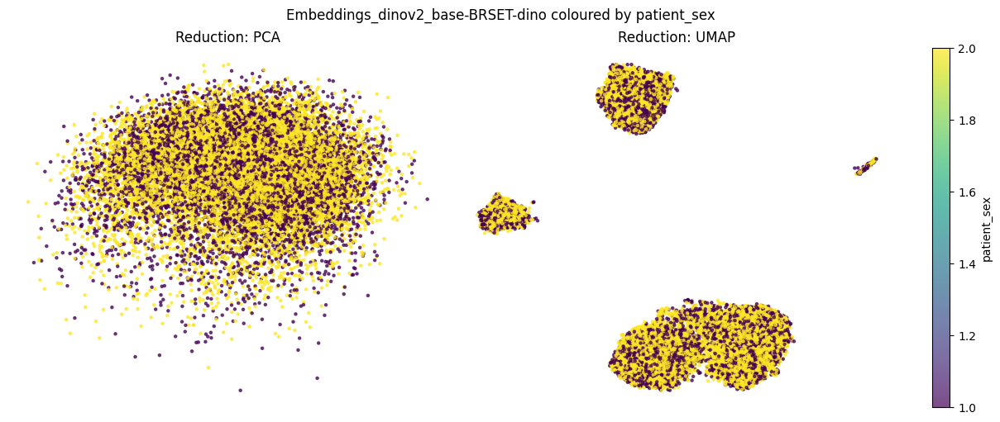

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


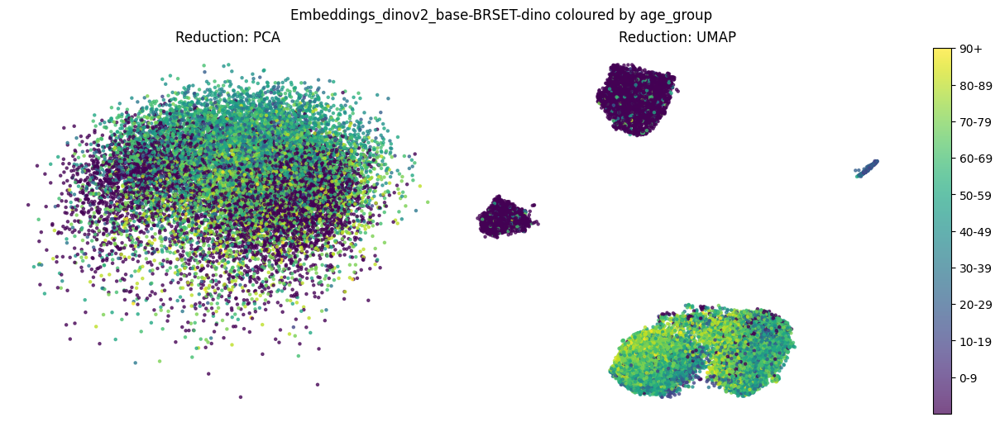

[I 2025-05-07 23:58:55,695] A new study created in memory with name: no-name-f2ddf0cd-268f-4827-9867-2fa923e6b3fc
[I 2025-05-07 23:59:08,700] Trial 0 finished with value: 0.9504227517294389 and parameters: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.4, 'drop2': 0.2, 'lr': 0.0008624790040399416, 'gamma': 1.5, 'batch_size': 128}. Best is trial 0 with value: 0.9504227517294389.
[I 2025-05-07 23:59:30,373] Trial 1 finished with value: 0.9504227517294389 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 0.001440392761409704, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.9504227517294389.
[I 2025-05-07 23:59:52,103] Trial 2 finished with value: 0.9592621060722522 and parameters: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.2, 'lr': 9.656100976524425e-05, 'gamma': 2.5, 'batch_size': 64}. Best is trial 2 with value: 0.9592621060722522.
[I 2025-05-08 00:00:05,135] Trial 3 finished with value: 0.9492697924673328 and p

→ Best params for binary: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.1, 'lr': 3.425440499480613e-05, 'gamma': 1.5, 'batch_size': 64}


[I 2025-05-08 00:09:10,612] A new study created in memory with name: no-name-de8f4acb-77bd-40d0-b2a8-0454da351dad


BINARY – Test acc=0.964, AUROC=0.941
              precision    recall  f1-score   support

           0      0.980     0.981     0.981      3043
           1      0.726     0.716     0.721       211

    accuracy                          0.964      3254
   macro avg      0.853     0.848     0.851      3254
weighted avg      0.964     0.964     0.964      3254



[I 2025-05-08 00:09:32,377] Trial 0 finished with value: 0.9423520368946964 and parameters: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 2.0884996581937808e-05, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.9423520368946964.
[I 2025-05-08 00:09:54,006] Trial 1 finished with value: 0.883935434281322 and parameters: {'hidden1': 128, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.4, 'lr': 1.1258568019727621e-05, 'gamma': 1.5, 'batch_size': 64}. Best is trial 0 with value: 0.9423520368946964.
[I 2025-05-08 00:10:16,181] Trial 2 finished with value: 0.9442736356648732 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.30000000000000004, 'drop2': 0.5, 'lr': 0.00010599119884381771, 'gamma': 1.0, 'batch_size': 64}. Best is trial 2 with value: 0.9442736356648732.
[I 2025-05-08 00:10:37,924] Trial 3 finished with value: 0.9431206764027671 and parameters: {'hidden1': 512, 'hidden2': 64, 'drop1': 0.30000000000000004, 'drop2':

→ Best params for 3class: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.00033966498292425744, 'gamma': 2.5, 'batch_size': 128}
3CLASS – Test acc=0.955, AUROC=0.937
              precision    recall  f1-score   support

           0      0.978     0.982     0.980      3043
           1      0.538     0.530     0.534       132
           2      0.714     0.633     0.671        79

    accuracy                          0.955      3254
   macro avg      0.744     0.715     0.728      3254
weighted avg      0.954     0.955     0.954      3254


=== Processing Embeddings_dinov2_base.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


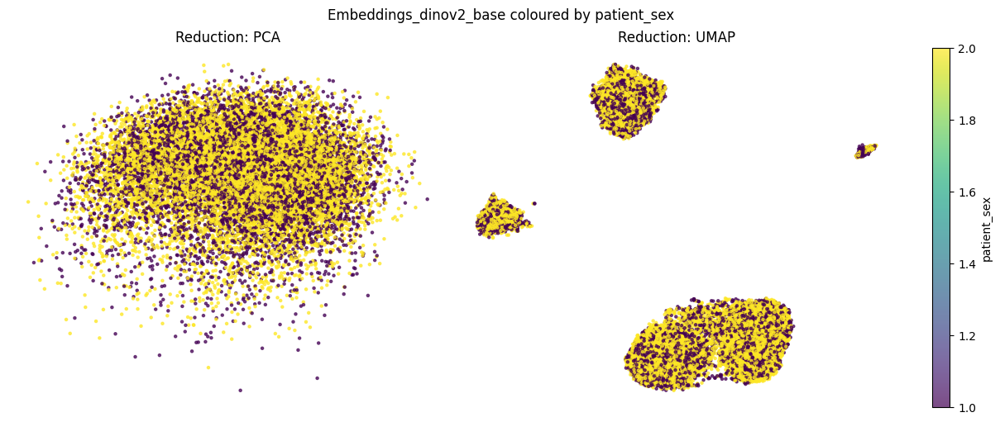

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


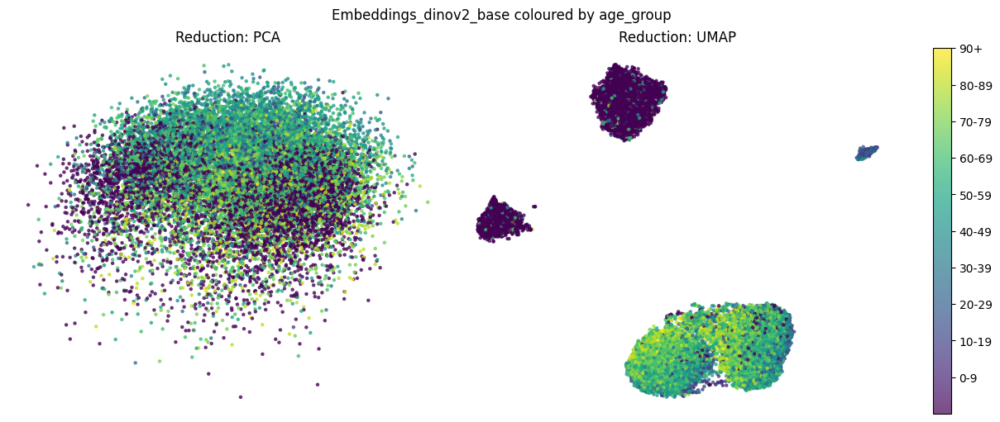

[I 2025-05-08 00:17:50,220] A new study created in memory with name: no-name-42487e93-eea8-46cf-8c5e-c1c45cc4c85a
[I 2025-05-08 00:18:11,924] Trial 0 finished with value: 0.9546502690238279 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.001010242441132872, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.9546502690238279.
[I 2025-05-08 00:18:24,960] Trial 1 finished with value: 0.9515757109915449 and parameters: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.5, 'lr': 0.008116428642540391, 'gamma': 1.5, 'batch_size': 128}. Best is trial 0 with value: 0.9546502690238279.
[I 2025-05-08 00:18:37,822] Trial 2 finished with value: 0.936587240584166 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.4, 'drop2': 0.2, 'lr': 7.10049814415199e-05, 'gamma': 1.0, 'batch_size': 128}. Best is trial 0 with value: 0.9546502690238279.
[I 2025-05-08 00:18:50,819] Trial 3 finished with value: 0.9561875480399693 and par

→ Best params for binary: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.1, 'drop2': 0.4, 'lr': 0.0002520798459954956, 'gamma': 1.5, 'batch_size': 128}


[I 2025-05-08 00:26:27,104] A new study created in memory with name: no-name-72f7efc7-9557-48f6-8216-be8e9daaa7be


BINARY – Test acc=0.959, AUROC=0.940
              precision    recall  f1-score   support

           0      0.980     0.976     0.978      3043
           1      0.677     0.716     0.696       211

    accuracy                          0.959      3254
   macro avg      0.829     0.846     0.837      3254
weighted avg      0.961     0.959     0.960      3254



[I 2025-05-08 00:26:39,966] Trial 0 finished with value: 0.9531129900076863 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.00021879782114710248, 'gamma': 1.5, 'batch_size': 128}. Best is trial 0 with value: 0.9531129900076863.
[I 2025-05-08 00:26:52,819] Trial 1 finished with value: 0.9373558800922367 and parameters: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.4, 'lr': 0.007452977819033393, 'gamma': 1.5, 'batch_size': 128}. Best is trial 0 with value: 0.9531129900076863.
[I 2025-05-08 00:27:14,586] Trial 2 finished with value: 0.9335126825518831 and parameters: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 2.3660433131841374e-05, 'gamma': 1.5, 'batch_size': 64}. Best is trial 0 with value: 0.9531129900076863.
[I 2025-05-08 00:27:27,557] Trial 3 finished with value: 0.9331283627978478 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.2, 'lr': 0.000465130549861

→ Best params for 3class: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.0010844538927361023, 'gamma': 1.0, 'batch_size': 128}
3CLASS – Test acc=0.949, AUROC=0.942
              precision    recall  f1-score   support

           0      0.980     0.973     0.977      3043
           1      0.503     0.553     0.527       132
           2      0.614     0.684     0.647        79

    accuracy                          0.949      3254
   macro avg      0.699     0.737     0.717      3254
weighted avg      0.952     0.949     0.951      3254


=== Processing Embeddings_vit_base-BRSET-byol.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


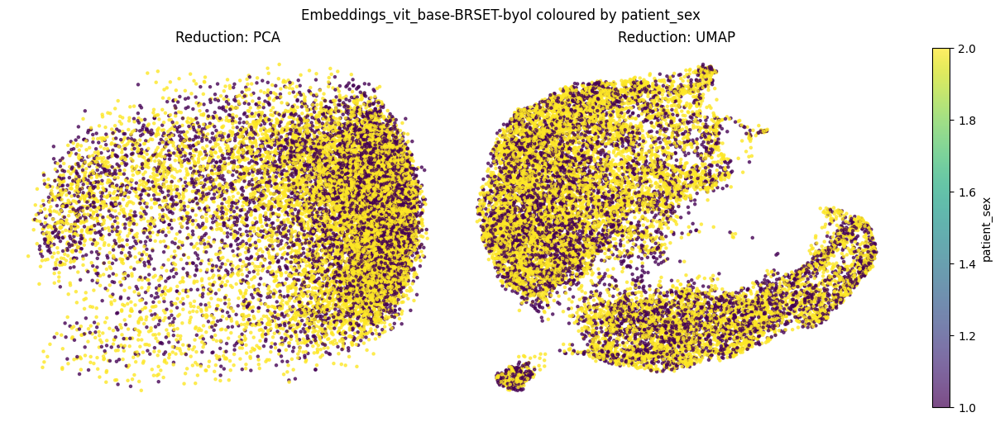

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


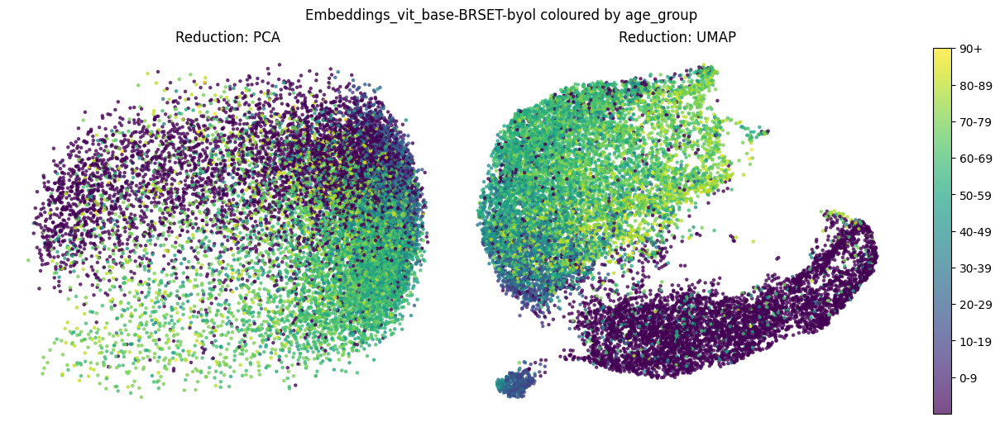

[I 2025-05-08 00:36:17,689] A new study created in memory with name: no-name-f68f5408-6ac7-4796-bc9e-fa4368c21a32
[I 2025-05-08 00:36:30,570] Trial 0 finished with value: 0.936587240584166 and parameters: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 5.670716914588843e-05, 'gamma': 1.5, 'batch_size': 128}. Best is trial 0 with value: 0.936587240584166.
[I 2025-05-08 00:36:52,350] Trial 1 finished with value: 0.9239046887009992 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.1, 'lr': 0.008392619415031931, 'gamma': 2.0, 'batch_size': 64}. Best is trial 0 with value: 0.936587240584166.
[I 2025-05-08 00:37:13,979] Trial 2 finished with value: 0.8435818601076095 and parameters: {'hidden1': 128, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 2.8644972481382584e-05, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.936587240584166.
[I 2025-05-08 00:37:26,841] Trial 3 finished with value: 0.9208301306

→ Best params for binary: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 0.0001646871971164818, 'gamma': 1.0, 'batch_size': 128}


[I 2025-05-08 00:43:51,143] A new study created in memory with name: no-name-57934f1a-8a08-4530-baa3-2770999b8aca


BINARY – Test acc=0.936, AUROC=0.910
              precision    recall  f1-score   support

           0      0.972     0.959     0.966      3043
           1      0.506     0.602     0.550       211

    accuracy                          0.936      3254
   macro avg      0.739     0.781     0.758      3254
weighted avg      0.942     0.936     0.939      3254



[I 2025-05-08 00:44:04,097] Trial 0 finished with value: 0.9104534973097618 and parameters: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.5, 'lr': 0.0006796951887135268, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.9104534973097618.
[I 2025-05-08 00:44:25,955] Trial 1 finished with value: 0.8662567255956957 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 1.1131133925474544e-05, 'gamma': 3.0, 'batch_size': 64}. Best is trial 0 with value: 0.9104534973097618.
[I 2025-05-08 00:44:47,782] Trial 2 finished with value: 0.9358186010760953 and parameters: {'hidden1': 384, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.00035285292033588873, 'gamma': 1.5, 'batch_size': 64}. Best is trial 2 with value: 0.9358186010760953.
[I 2025-05-08 00:45:09,627] Trial 3 finished with value: 0.9292851652574943 and parameters: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.1, 'lr': 0.000119539513876

→ Best params for 3class: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.2, 'lr': 7.937086104590013e-05, 'gamma': 1.0, 'batch_size': 64}
3CLASS – Test acc=0.923, AUROC=0.882
              precision    recall  f1-score   support

           0      0.969     0.958     0.963      3043
           1      0.295     0.371     0.329       132
           2      0.487     0.494     0.491        79

    accuracy                          0.923      3254
   macro avg      0.584     0.607     0.594      3254
weighted avg      0.930     0.923     0.926      3254


=== Processing Embeddings_vit_base-BRSET-contrastive.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


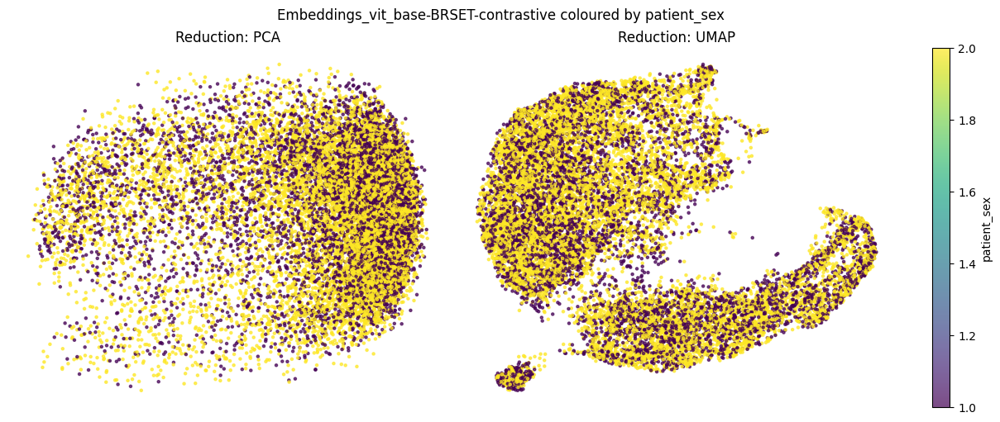

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


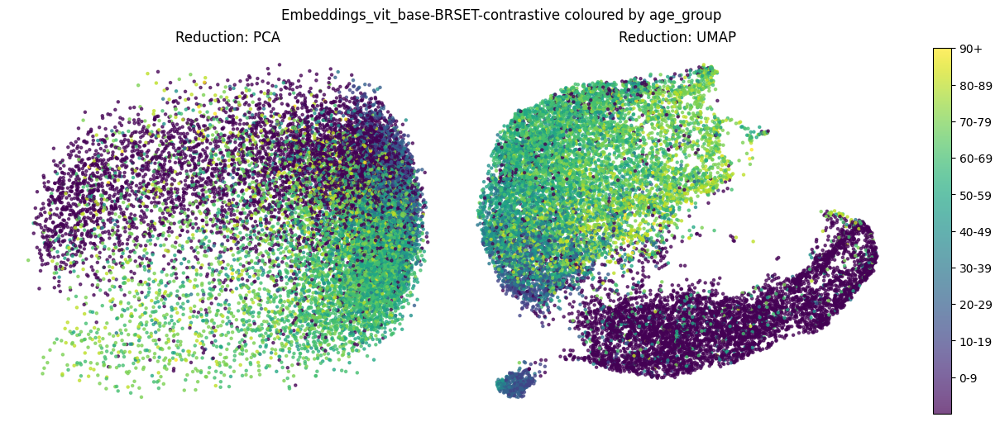

[I 2025-05-08 00:54:42,571] A new study created in memory with name: no-name-fd5ec020-d181-4583-ad02-432d5f3ecc6e
[I 2025-05-08 00:54:55,500] Trial 0 finished with value: 0.9458109146810146 and parameters: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.4, 'lr': 0.00011564541360788475, 'gamma': 1.0, 'batch_size': 128}. Best is trial 0 with value: 0.9458109146810146.
[I 2025-05-08 00:55:08,295] Trial 1 finished with value: 0.9185242121445042 and parameters: {'hidden1': 128, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.4, 'lr': 0.0001946009086614884, 'gamma': 2.5, 'batch_size': 128}. Best is trial 0 with value: 0.9458109146810146.
[I 2025-05-08 00:55:21,300] Trial 2 finished with value: 0.9335126825518831 and parameters: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.30000000000000004, 'drop2': 0.2, 'lr': 7.35318502634424e-05, 'gamma': 2.0, 'batch_size': 128}. Best is trial 0 with value: 0.9458109146810146.
[I 2025-05-08 00:55:43,197] Trial 3 finished w

→ Best params for binary: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.30000000000000004, 'drop2': 0.4, 'lr': 0.00011564541360788475, 'gamma': 1.0, 'batch_size': 128}


[I 2025-05-08 01:02:13,208] A new study created in memory with name: no-name-7ae313ee-0af3-4d58-8f90-87fda31fbc57


BINARY – Test acc=0.935, AUROC=0.917
              precision    recall  f1-score   support

           0      0.978     0.951     0.965      3043
           1      0.498     0.697     0.581       211

    accuracy                          0.935      3254
   macro avg      0.738     0.824     0.773      3254
weighted avg      0.947     0.935     0.940      3254



[I 2025-05-08 01:02:25,954] Trial 0 finished with value: 0.8931591083781706 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.5, 'lr': 0.004262820008092251, 'gamma': 2.5, 'batch_size': 128}. Best is trial 0 with value: 0.8931591083781706.
[I 2025-05-08 01:02:47,933] Trial 1 finished with value: 0.855880092236741 and parameters: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.5, 'lr': 1.4187356646701926e-05, 'gamma': 1.0, 'batch_size': 64}. Best is trial 0 with value: 0.8931591083781706.
[I 2025-05-08 01:03:00,842] Trial 2 finished with value: 0.8566487317448117 and parameters: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.5, 'lr': 4.695607938409611e-05, 'gamma': 3.0, 'batch_size': 128}. Best is trial 0 with value: 0.8931591083781706.
[I 2025-05-08 01:03:22,535] Trial 3 finished with value: 0.9185242121445042 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 0.002945755923930262

→ Best params for 3class: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.4, 'lr': 7.202777060876355e-05, 'gamma': 2.0, 'batch_size': 64}
3CLASS – Test acc=0.920, AUROC=0.875
              precision    recall  f1-score   support

           0      0.972     0.954     0.963      3043
           1      0.249     0.341     0.288       132
           2      0.523     0.582     0.551        79

    accuracy                          0.920      3254
   macro avg      0.581     0.626     0.600      3254
weighted avg      0.932     0.920     0.925      3254


=== Processing Embeddings_vit_base-BRSET-dino.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


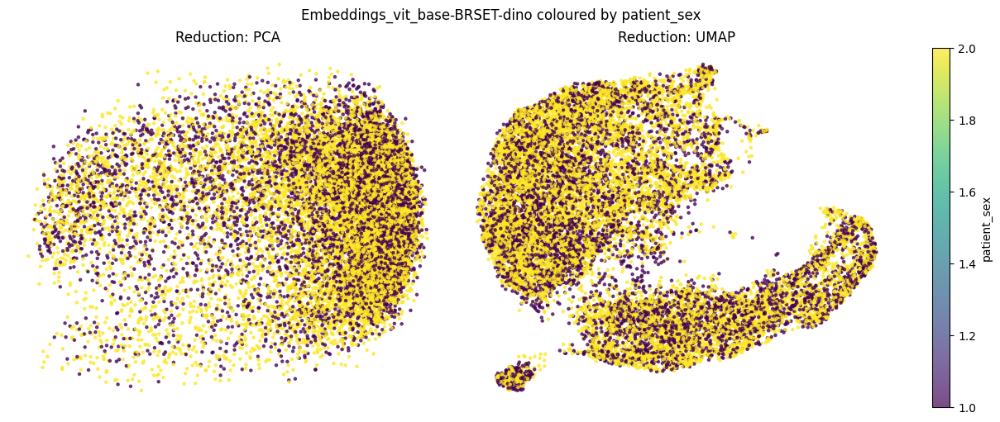

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


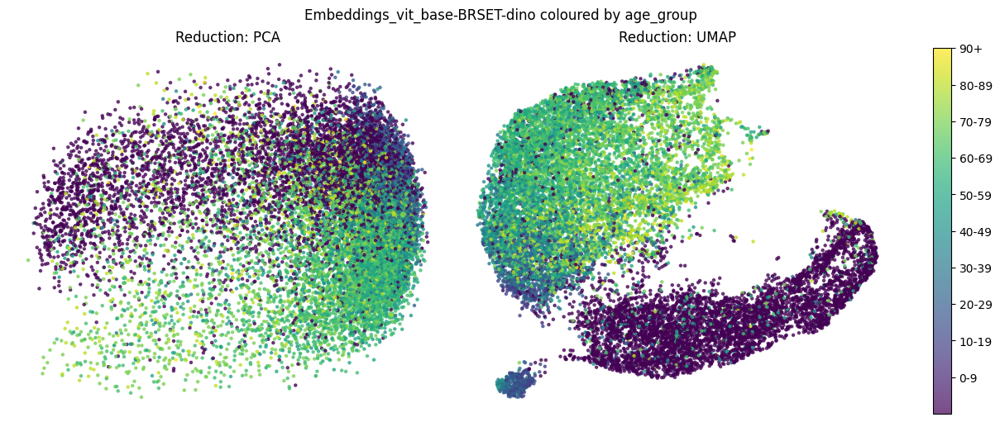

[I 2025-05-08 01:13:01,944] A new study created in memory with name: no-name-9bf4f204-f069-49a3-865d-388bef8f6016
[I 2025-05-08 01:13:23,738] Trial 0 finished with value: 0.9273635664873174 and parameters: {'hidden1': 384, 'hidden2': 256, 'drop1': 0.4, 'drop2': 0.30000000000000004, 'lr': 0.0002467147695421952, 'gamma': 1.5, 'batch_size': 64}. Best is trial 0 with value: 0.9273635664873174.
[I 2025-05-08 01:13:45,291] Trial 1 finished with value: 0.93543428132206 and parameters: {'hidden1': 384, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.5, 'lr': 0.0001900032614260875, 'gamma': 2.0, 'batch_size': 64}. Best is trial 1 with value: 0.93543428132206.
[I 2025-05-08 01:14:06,843] Trial 2 finished with value: 0.9139123750960799 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 0.0006520739223741735, 'gamma': 1.5, 'batch_size': 64}. Best is trial 1 with value: 0.93543428132206.
[I 2025-05-08 01:14:19,619] Trial 3 finished with value: 0.9169869331283

→ Best params for binary: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.4, 'lr': 0.00010721100741448607, 'gamma': 1.0, 'batch_size': 128}


[I 2025-05-08 01:20:41,689] A new study created in memory with name: no-name-6b26f36a-4702-4b62-ad8c-5ac626dd9f99


BINARY – Test acc=0.929, AUROC=0.890
              precision    recall  f1-score   support

           0      0.973     0.950     0.961      3043
           1      0.463     0.621     0.530       211

    accuracy                          0.929      3254
   macro avg      0.718     0.785     0.746      3254
weighted avg      0.940     0.929     0.933      3254



[I 2025-05-08 01:21:03,299] Trial 0 finished with value: 0.898923904688701 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.4, 'drop2': 0.2, 'lr': 0.00044768708358404105, 'gamma': 3.0, 'batch_size': 64}. Best is trial 0 with value: 0.898923904688701.
[I 2025-05-08 01:21:16,213] Trial 1 finished with value: 0.9189085318985396 and parameters: {'hidden1': 512, 'hidden2': 192, 'drop1': 0.4, 'drop2': 0.30000000000000004, 'lr': 0.00021873318141885683, 'gamma': 1.5, 'batch_size': 128}. Best is trial 1 with value: 0.9189085318985396.
[I 2025-05-08 01:21:28,918] Trial 2 finished with value: 0.8946963873943121 and parameters: {'hidden1': 128, 'hidden2': 64, 'drop1': 0.5, 'drop2': 0.5, 'lr': 0.0024096814739262722, 'gamma': 1.5, 'batch_size': 128}. Best is trial 1 with value: 0.9189085318985396.
[I 2025-05-08 01:21:50,564] Trial 3 finished with value: 0.8946963873943121 and parameters: {'hidden1': 128, 'hidden2': 256, 'drop1': 0.30000000000000004, 'drop2': 0.1, 'lr': 0.00193091481717714

→ Best params for 3class: {'hidden1': 256, 'hidden2': 128, 'drop1': 0.1, 'drop2': 0.30000000000000004, 'lr': 0.00012359282852585717, 'gamma': 3.0, 'batch_size': 128}
3CLASS – Test acc=0.915, AUROC=0.892
              precision    recall  f1-score   support

           0      0.973     0.949     0.961      3043
           1      0.265     0.379     0.312       132
           2      0.421     0.506     0.460        79

    accuracy                          0.915      3254
   macro avg      0.553     0.612     0.577      3254
weighted avg      0.931     0.915     0.922      3254


=== Processing Embeddings_vit_base.csv ===


/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


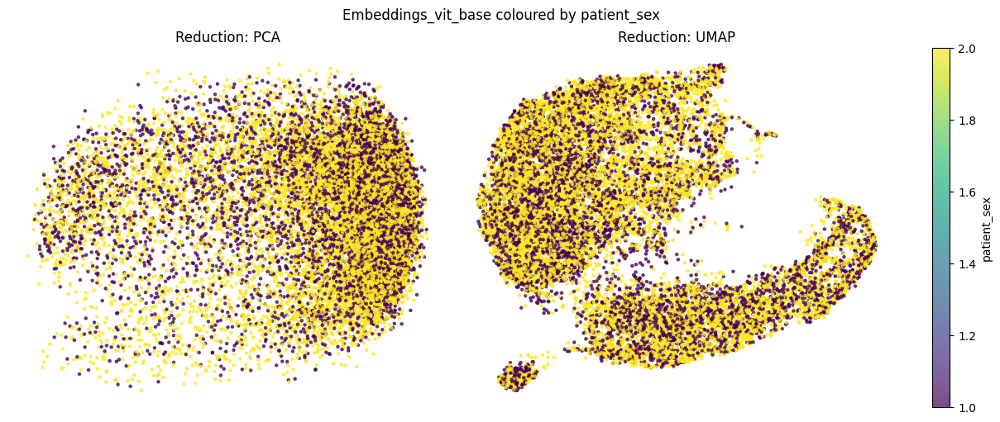

/gpfs/users/restrepoda/.conda/envs/base_ml/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(
/gpfs/workdir/restrepoda/tmp/ipykernel_12921/1139154739.py:203: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  elif ptypes.is_categorical_dtype(vals) and vals.dtype.ordered:


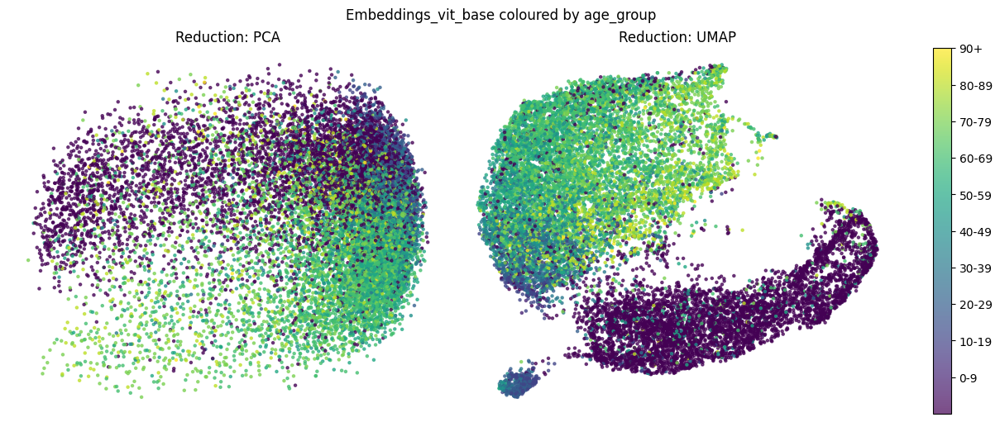

[I 2025-05-08 01:28:59,273] A new study created in memory with name: no-name-18167dbf-3467-4831-a800-4a8acad27b91
[I 2025-05-08 01:29:20,925] Trial 0 finished with value: 0.9338970023059185 and parameters: {'hidden1': 256, 'hidden2': 64, 'drop1': 0.2, 'drop2': 0.2, 'lr': 0.009314404297926283, 'gamma': 1.5, 'batch_size': 64}. Best is trial 0 with value: 0.9338970023059185.
[I 2025-05-08 01:29:42,660] Trial 1 finished with value: 0.9085318985395849 and parameters: {'hidden1': 512, 'hidden2': 128, 'drop1': 0.5, 'drop2': 0.30000000000000004, 'lr': 0.001782592437933781, 'gamma': 2.5, 'batch_size': 64}. Best is trial 0 with value: 0.9338970023059185.
[I 2025-05-08 01:29:55,512] Trial 2 finished with value: 0.9411990776325904 and parameters: {'hidden1': 384, 'hidden2': 128, 'drop1': 0.2, 'drop2': 0.1, 'lr': 0.0018366492177797193, 'gamma': 1.0, 'batch_size': 128}. Best is trial 2 with value: 0.9411990776325904.
[I 2025-05-08 01:30:17,054] Trial 3 finished with value: 0.9158339738662568 and par

→ Best params for binary: {'hidden1': 512, 'hidden2': 256, 'drop1': 0.1, 'drop2': 0.2, 'lr': 0.0005301503639811022, 'gamma': 2.5, 'batch_size': 128}


[I 2025-05-08 01:36:39,224] A new study created in memory with name: no-name-abef9ddd-6fa7-4aa8-9744-da02830d0ea6


BINARY – Test acc=0.924, AUROC=0.912
              precision    recall  f1-score   support

           0      0.973     0.945     0.959      3043
           1      0.440     0.626     0.517       211

    accuracy                          0.924      3254
   macro avg      0.707     0.785     0.738      3254
weighted avg      0.939     0.924     0.930      3254



[I 2025-05-08 01:36:51,999] Trial 0 finished with value: 0.8708685626441199 and parameters: {'hidden1': 256, 'hidden2': 256, 'drop1': 0.5, 'drop2': 0.2, 'lr': 0.00013076443026147655, 'gamma': 1.5, 'batch_size': 128}. Best is trial 0 with value: 0.8708685626441199.
[I 2025-05-08 01:37:13,670] Trial 1 finished with value: 0.9242890084550346 and parameters: {'hidden1': 384, 'hidden2': 64, 'drop1': 0.1, 'drop2': 0.1, 'lr': 1.8959011118470103e-05, 'gamma': 3.0, 'batch_size': 64}. Best is trial 1 with value: 0.9242890084550346.
[I 2025-05-08 01:37:26,469] Trial 2 finished with value: 0.9227517294388932 and parameters: {'hidden1': 128, 'hidden2': 192, 'drop1': 0.2, 'drop2': 0.2, 'lr': 0.00012872209598187626, 'gamma': 3.0, 'batch_size': 128}. Best is trial 1 with value: 0.9242890084550346.
[I 2025-05-08 01:37:39,234] Trial 3 finished with value: 0.8297463489623367 and parameters: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.5, 'drop2': 0.2, 'lr': 1.7822022984526076e-05, 'gamma': 2.5, 'batch_siz

→ Best params for 3class: {'hidden1': 256, 'hidden2': 192, 'drop1': 0.1, 'drop2': 0.4, 'lr': 7.955351326475377e-05, 'gamma': 2.0, 'batch_size': 128}
3CLASS – Test acc=0.921, AUROC=0.881
              precision    recall  f1-score   support

           0      0.972     0.956     0.964      3043
           1      0.276     0.364     0.314       132
           2      0.448     0.494     0.470        79

    accuracy                          0.921      3254
   macro avg      0.565     0.604     0.582      3254
weighted avg      0.931     0.921     0.926      3254


✓ All done – see the 'embedding_reports/' folder for plots & summaries.


In [2]:
for name, cfg in DATASETS.items():
    run_pipeline(cfg)
print("\n✓ All done – see the 'embedding_reports/' folder for plots & summaries.")